# Biology Schedule Processing

## Purpose & Rationale

Many scheduling tasks benefit from a comprehensive view of past teaching. However, it can be challenging to understand this by clicking through individual pages on the UW Bothell web site. This script automates the process. 

The script produces a summary `master_schedule.csv` file that can be opened in Excel and is useful for finding which classes have been taught by which instructors, what each class number means, etc. **However, because the format of web reports can be inconsistent, all summarized data should be manually cross-checked before being used for critical tasks**. If you notice any problems, please submit a GitHub issue.


## Set up code for parsing class schedules

Class schedules are listed openly online, but the format is not very consistent, so it takes a significant amount of work to collect all the data into a spreadsheet.

In [43]:
import pandas as pd
class ClassSection(object):
    def __init__(self,text,current_class="-",class_number="-"):
        
        self.ExpectedFields = ['Class','Restrictions','Add Code Required','SLN', 'ID', 'Credit', 'Laboratory','Meeting Day', 
                           'Meeting Times','Building','Room', 'Instructor', 'Status', 'Enrolled', 
                            'Enrollment Limit','Grades','Fee','Other']
        
        self.Class = current_class
        self.Text = self.preprocess_text(text)
        self.Fields = self.extract_fields()
        self.Fields = self.postprocess_fields()
        self.ExpectedFields.insert(0,"Class Number")
        self.Fields.insert(0,class_number) 
        
    def postprocess_fields(self):
        """Postprocess fields"""
        print("Postprocessing fields...")
        new_fields = []
        for i,field in enumerate(self.Fields):
            label = self.ExpectedFields[i]
            if label == "Instructor":
                print(">"*40)
                print(f"Postprocessing name: {field}")
                #Should capitalize these better
                if not "," in field:
                    #Probably a placeholder like "-"
                    #append 'as is'
                    new_fields.append(field)
                    continue
                
                field = field.replace(",",", ")
                field = field.title()
              

                new_words = []
                for i,word in enumerate(field.split()):
                    word = word[0].upper()+word[1:] 
                    print("word:",word)
                    #Capitalize after Mc, as in McNabb
                    if word.startswith("Mc") and len(word) > 2:
                        word = "Mc"+word[2:].title()
                        
                    if (word.startswith("al-") or word.startswith("AL-")) and i > 0:
                        #Arabic names with 'al-' are only capitalized at
                        #the start of a name 
                        pre,post = word.split("-")
                        pre = pre.lower()
                        post = post.title()
                        word = "-".join([pre,post])
                    new_words.append(word)
                field = " ".join(new_words)
                
                print(f"Postprocessed name: {field}")
                print(">"*40)
            
            new_fields.append(field)
        return new_fields
            
    
    
    
    def extract_fields(self):
        """Extract fields from self.Text"""
        self.Fields = [self.Class]
        
        self.Fields.extend(self.Text.split())
        print("STARTING FIELDS:",self.Fields)
        
        self.Fields = self.collapse_name_fields()
        
        print("*"*80)
        expected_fields = self.ExpectedFields
        result = {}
        
        fields = self.Fields
        skip_next_field = False
        for i,field_text in enumerate(fields): 
            
                
            if skip_next_field:
                print(f"Already assigned {field_text}...skipping")
                skip_next_field = False
                continue
                
            if "Restr" in field_text:
                print("Text Restr only shows up in restrictions field")
                result["Restrictions"] = field_text
                fields.remove("Restr")
                continue
            
            found_valid_field = False
            skip = 0
            
            while not found_valid_field: 
                
                #Check we haven't reached the end
                if i+skip >= len(expected_fields):
                    #Just add this to other
                    print("Hit end of fields, just adding this field to Other.")
                    result["Other"] = result.get("Other","") + f" Note: couldn't interpret '{field_text}', in original."
                    break
                    
                putative_field = expected_fields[i+skip]
                if result.get(putative_field,None) is not None:
                    print(result)
                    print(f"Already have an entry for {putative_field}...{field_text} must be for the next field.")
                    skip += 1
                    continue
                    
                if self.validate(putative_field,field_text):
                    result[putative_field] = field_text
                    found_valid_field = True
                    
                    #Special case for multiword instructor name like Horn,Teresa Marie
                    if putative_field == "Instructor":
                        next_entry = fields[i+1]
                        print(f"Checking if {next_entry} might be part of instructor name {field_text}")
                        if next_entry not in ["Open","Closed"]:
                            if next_entry.istitle() or next_entry.isupper() or self.validate("Instructor",next_entry):
                                print("It is! Adding to name")
                                result[putative_field] += " "+next_entry
                                #We already found the next field was a name, so skip the next field
                                skip_next_field=True
                    print(f'Validated field {i}, "{field_text}" as {putative_field}')
                else:
                    #If invalid, maybe this is really the next field?
                    #fill this one in as missing and move on
                    print(f"{field_text} ({i}) DID NOT validate as {putative_field}. Maybe this field was skipped and it is really {expected_fields[i+skip+1]}?")
                    result[putative_field] = "-"
                    skip += 1
        print(f"Result:{result}")       
        self.Fields = [result.get(expected_field,"-") for i,expected_field in enumerate(self.ExpectedFields)]
        return self.Fields
    
    def collapse_name_fields(self,before_name_field="Room",after_name_field="Status"):
        """Returns a collapsed version of multi-part names. 
        
        This helps avoid issues since names are not quoted, nor are columns delimited consistently."""
        fields = self.Fields
        end_index=len(fields)
        begin_index = 0
        
        
        for i,field_text in enumerate(fields):
            #print(f"On index {i}/{len(fields)}")
            if i+1 >= len(fields):
                print("Didn't find status field but at end of fields, aborting")
                return fields
                
            if self.validate(before_name_field,field_text) and not self.validate(before_name_field,fields[i+1]):
                #print("Found Room field:",field_text)
                begin_index = i+1
                continue
            
            if self.validate(after_name_field,field_text):
                end_index = i-1
                #print("Found Status field",field_text)
                break
        
        #If there's only one field between Rooom and Status,
        #it must be the name. All is well and no change is needed
        if begin_index == end_index:
            print("Just one name field, no need to collapse")
            return fields
        
        if end_index == len(fields):
            #Couldn't find reasonable end point, might be missing normal fields like status???
            #Just guess normal position of name
            
            best_guess_name_field = 11
            if self.validate("Instructor",fields[best_guess_name_field]):
                print(f"Might be missing status? Just guessing that field {best_guess_name_field} ('{fields[best_guess_name_field]}') holds a name.")
                return fields[best_guess_name_field]
            
        #If any of these fields look weird, don't precollapse
        #and instead just return the original fields
        print(f"Deciding whether to precollapse name fields")
        weird = False
        for f in fields[begin_index:end_index]:
            for c in str(f):
                if str(c).isdigit():
                    print(f"Weird! Found {c} in field {f} of entry {fields}")
                    print("Returning original fields without collapsing")
                    weird = True
            if weird:
                return fields
            
        print("First name field:",begin_index)
        print("Last name field:",end_index)
        new_fields = [f for f in fields[0:begin_index]]
        new_fields.append("_".join(fields[begin_index:end_index]))
        print("Collapsed name field:",new_fields[-1])
        final_fields = fields[end_index:]
        new_fields.extend(final_fields)
        return new_fields
            
    def validate(self,field_name,text):
        """Validate field names
        
        Since the number of fields isn't consistent, we have to guess which data goes with which column. It's relatively
        easy by eye, but hard for code. This code tests whether an entry *could be* a name, SLN, time, etc 
        to try to sort out the proper order.
        
        Field names are: 'Class','Restrictions','Add Code Required','SLN', 'ID', 'Credit', 'Laboratory,'Meeting Day', 
                           'Meeting Times','Building','Room', 'Instructor', 'Status', 'Enrolled', 
                            'Enrollment Limit','Grades','Fee','Other']
        
        """
        field_name = field_name.strip()
        if field_name == "Class":
            if text.isupper() and len(text) > 5:
                return True
            
            return False
        if field_name == "Restrictions":
            #Valid entries are independent_study or add_code_required
            valid_entries = ["no_restriction","independent_study","restr","IS"]
            if text.strip() in valid_entries:
                return True
            else:
                return False
        
        if field_name == "Instructor":
            
            #Should have the form Galindo,Heather
            if "," in text:
                return True
            
            forbidden_names = ["UWBB","DISC","SSG CNSVTRY","Open","Closed"]
            for f in forbidden_names:
                if f in text:
                    return False
                
            #Names should be alphabetical
            try:
                if not text.alpha():
                    return False
            except:
                if not text.isalpha():
                    return False
            
            if text.istitle() or text.isupper() or text.islower():
                return True
            
            return False
        
        if field_name == 'Add Code Required':
            if text == 'add_code_required':
                return True
            if text == 'no_add_code':
                return True
            return False
        
        if field_name == "Building":
            if text == "*":
                #Used for online classes
                return True
            if "," in text:
                return False
            if not text.isupper():
                return False
            
        if field_name == "Room":
            
            #Could be an online class
            if text == "*":
                return True
            try:
                text = int(text)
                return True
            except ValueError:
                #Could be combo like "107G"
                if text[0:-1].isdigit() and text[-1].isalpha():
                    return True
                
                if text == "CNSVTRY":
                    #Conservatory
                    return True
                #If not this is something else
                return False
        
        
        if field_name == "SLN":
            try:
                int(text)
                return True
            except ValueError:
                return False
            
        if field_name == "ID":
            if len(text) <= 3 and text.isupper():
                return True
            else:
                return False
        
        if field_name == "Credit":
            #Remove text like 'A_1-5'
            if "_" in text:
                prefix,text = text.split("_")
                
            if "-" in text:
                min_credit,n_credit = text.split("-")
                n_credit = int(n_credit)
                if int(min_credit) != 1:
                    return False
            else:
                try:
                    n_credit = int(text)
                except ValueError:
                    return False
            
            if n_credit >= 10:
                return False
            
            return True
            
        if field_name == "Laboratory":
            #If it's a lab or studio with a code like LB or ST,
            #it's a good entry for the credit column
            
            if text in ["CK","CL","CO","IS","LB","LC","PR","QZ","SM","ST"]:
                return True
            
            return False
            
        if field_name == "Grades":
            if "CR_NC" in text or "CR/NC" in text or "conventional" in text:
                return True
            else:
                return False
            
        if field_name == "Fee":
            if "$" in text:
                return True
            else:
                return False
            
        if field_name == "Meeting Day":
            valid_days = ["M","T","W","Th","F"]
            found_valid_first_day = False
            for v in valid_days:
                if text.startswith(v):
                    found_valid_first_day = True
            if not found_valid_first_day:
                return False
            
            found_valid_last_day = False
            for v in valid_days:
                if text.endswith(v):
                    found_valid_last_day = True
            if not found_valid_last_day:
                return False
            
            if found_valid_first_day and found_valid_last_day:
                return True
            
        if field_name == "Meeting Times":
            
            if "to be arranged" in text or "to_be_arranged" in text:
                return True
            
            if not "-" in text:
                return False
            start,end = text.split("-")
            if len(start) > 4:
                return False
            if len(end) > 4:
                return False
            
            #Ignore the p in 5:45-7:45P
            if text.endswith("P") or text.endswith("p"):
                text = text[:-1]
            try:
                start = int(start)
                end = int(end)
                
                if start > 2400 or end >2400:
                    return False
                
            except ValueError:
                return False
            
            return True
        
        if field_name == "Enrolled" or field_name == "Enrollment Limit":
            try:
                text = int(text)
            except ValueError:
                return False
            
            max_plausible_enrollment = 1000
            if text > max_plausible_enrollment:
                return False
            else:
                return True
            
        if field_name == "Status":
            if text in ["Open","Closed"]:
                return True
            else:
                return False
            
        if field_name == "Other":
            #One letter codes:
            if text.upper() and len(text): 
                return True
        print(f"No checks done on field '{field_name}'")
            
        return True
        
    def preprocess_text(self,text):
        """Preprocess text to remove inconsistent formatting"""
        text = text.replace("\r","")
        text = text.replace("to be arranged","to_be_arranged")
        text = text.replace("CR/NC","CR_NC")
        text = text.replace("/ "," ")
        text = text.replace("IS\w>","independent_study add_code_required ")
        text = text.replace(">","add_code_required ")
        text = text.replace(" IS "," independent_study add_code_required")
        text = text.lstrip()
        text = text.strip()
        
        #Annoyingly, restrictions field is left blank if there are no restrictions
        #So we have to fill in blanks
    
        restricted = False
        restriction_codes = ["IS","add_code_required ",
                             "independent_study",
                             "independent_study add_code_required "]
        for r in restriction_codes:
            if r in text:
                print("Already restricted!")
                restricted = True
        
        if restricted == False:
            text = " ".join(["no_restriction no_add_code",text.lstrip()])
        
        if "no_restriction no_add_code IS" in text:
            text.replace("no_restriction no_add_code IS","IS add_code_required") 
            
        return text

## Define functions for scraping the schedule from the UW Bothell website

In [44]:
#NOTE: BeautifulSoup comes with Anaconda Python

import requests
from bs4 import BeautifulSoup
from collections import defaultdict

#Example website for a division
#fall_schedule_website = "https://www.washington.edu/students/timeschd/B/AUT2024/bbio.html"
#fall_schedule_page = requests.get(fall_schedule_website)


def scrape_schedule(quarter,year,division_shorthand="bbio"):
    """Return a pandas dataframe of the schedule for a given quarter and year
    
    quarter - "AUT","WIN","SPR"
    year - four digit year 2024 etc
    division_shorthand - abbreviation for division e.g. "bbio"
    """
    schedule_page = quarter + str(year)
    web_address = f"https://www.washington.edu/students/timeschd/B/{schedule_page}/{division_shorthand}.html"
    print(f"About to scrape {division_shorthand} schedule for {quarter} {year} from:\n {web_address}")
    schedule_page = requests.get(web_address)
    results_df = extract_class_info(schedule_page,division_shorthand)
    return results_df

    
def extract_class_info(page,division_shorthand):
    """From a UW Bothell schedule page, extract schedule information"""        
    
    results = defaultdict(list)
    
    soup = BeautifulSoup(page.content,"html.parser")
    
    #Schedule web page is formatted as non-nested tables
    #In other words, the header for a class is a separate HTML table from 
    #the actual info on sections of a class. So we have to iterate over tables
    #and keep track of which class we're in.
    
    tables = soup.find_all("table")
    current_class = None
    current_class_number = None
    header_dict = {}
    for t in tables:
        table_headers = t.find_all("a",href=True)
        
        #Class headers are the only rows with e.g. bbio.html in them
        for i,h in enumerate(table_headers):
            
           
                
            if f"{division_shorthand}.html" in h.prettify():
                full_header = str(h)
                class_number = full_header.split("#")[1].split('"')[0]
                class_number = class_number.upper()
                print("Class number:",class_number)
                current_class = h.text
                print(f"Processing schedule for class: {current_class}")
        
            
        unscheduled_classes = ["IND STUDY BIOL","UG RESEARCH BIOL"]
        unscheduled = False
        for c in unscheduled_classes:
            if current_class and c in current_class:
                unscheduled = True
        if unscheduled:
            print(f"Skipping class {current_class} ... it has no scheduled meeting time")
            continue
        #Instructors are *also* tables
        #but always use preformatted text style
        preformatted_text_rows = t.find_all("pre")
        
        
        for r in preformatted_text_rows:
            text = r.text
            if text.startswith("Enrl"):
                header_dict = parse_header_line(text,use_hardcoded=True)
                continue
            
            #print(f"Parsing row text: {text}")
            unscheduled_classes = ["IND STUDY BIOL","UG RESEARCH BIOL"]
            unscheduled = False
            for c in unscheduled_classes:
                if current_class and c in current_class:
                    unscheduled = True
            if unscheduled:
                print(f"Skipping class {current_class} ... it has no scheduled meeting time")
                continue
                
            if "RESERVE" in text:
                print("Reserved section not yet filled ... skipping")
                continue
            #The logic for parsing an intructor entry is sort of annoying since empty entries aren't marked
            #but just skipped, resulting in rows with 8-14 fields, depending. 
            #We'll handle parsing these rows in another function
            fields = parse_section_entry(text,header_dict,current_class=current_class,class_number=class_number)
            print("FINAL FIELDS:",fields)
            #Now add data from this class to lists
            #in our column dict, which will become columns
            #in the output data sheet
            for i,text in enumerate(fields):
                label = header_dict[i]
                print(f"{label} = {text}")
        
                #Grow columns of data in results
                #dict
                results[label].append(text)
                
            
    print(results)
    #Check results to see if any columns are off
    print("CHECK RESULTS")
    for k in results.keys():
        print(k,results[k],len(results[k]))
    results_df = pd.DataFrame(results,columns = [header_dict[i] for i in range(len(header_dict))])
    return results_df

def parse_header_line(text,use_hardcoded=True):
    """Return a dict mapping column indices to column names
    
    use_hardcoded -- ignore actual header line and use a hardcoded alternative
    """
    newline_count = text.count("\n")
    header_rows = text.split("\n")
    best_header_dict = {}
    for row_text in header_rows:
        #Split out header fields combined with a slash (eg. bldg/room or enrl/max)
        row_text = row_text.replace("/"," ")
        header_fields = row_text.split()
        curr_header_dict = {i:colname for i,colname in enumerate(header_fields)}
        if len(curr_header_dict) > len(best_header_dict):
            best_header_dict = curr_header_dict
            
    if use_hardcoded:
        best_header_dict = {0: 'Class Number',
                            1: 'Class',
                            2: 'Restrictions',
                            3: 'Add Code Required',
                            4: 'SLN', 
                            5: 'ID', 
                            6: 'Credit', 
                            7: 'Laboratory',
                            8: 'Meeting Day', 
                            9: 'Meeting Times',
                            10: 'Building',
                            11: 'Room', 
                            12: 'Instructor', 
                            13: 'Status', 
                            14: 'Enrolled', 
                            15: 'Enrollment Limit', 
                            16: 'Grades',\
                            17: 'Fee', 
                            18: 'Other'}
    return best_header_dict
    
def parse_section_entry(row_text,header_dict,n_expected_fields=16,current_class=None,class_number=None):
    """Return a list of exactly fields for instructor row
    
    Note: entries can have more than one row
    if they include notes. These are separated by <br> elements
    within the preformatted block
    """
    
    row_text = row_text.strip()
    print("-"*80)
    br_count = row_text.count("<br>")
    #print(f"<br> elements: {br_count}")
    
    newline_count = row_text.count("\n")
    #print(f"\\n elements: {newline_count}")
    
    if newline_count:
        class_lines = row_text.split("\n")
        row_text = class_lines[0] 
        comment_text = "\n".join(class_lines[1:])
    
    
    print(row_text)
    fields = [current_class]
    fields.extend(row_text.split())
    
    print(f"ORIGINAL ROW (length {len(fields)}): {fields}")
    #Substitute funky characters that prevent us from processing row fields
    text = row_text
    
    
    
    
    section = ClassSection(text,current_class=current_class,class_number=class_number)
    
    return section.Fields

## Compile schedules for each division, year and quarter

These will be saved as separate `.csv` files in `../schedules/`. They will be merged in the next step into a single overall historic schedule

In [49]:
overall_csv = None
import numpy as np
from os import mkdir
from os.path import join,exists
next_quarter = "AUT"
current_year = 2025

for division in ['BST','BBIO','BDATA','BCORE','BEARTH','BCHEM','CSS','BIS']:
    for year in range(2016,2026):
        for quarter in ["AUT","WIN","SPR","SUM"]:
            #quarter = "AUT"
            #year = 2024
            quarter_to_number = {"WIN":"1","SPR":"2","SUM":"3","AUT":"4"}
            quarter_number = quarter_to_number[quarter]
            if year == current_year and quarter_number > quarter_to_number[next_quarter]:
                print(f"No data available for {division} {year}, {quarter} - more than one quarter into the future")
                continue
            schedule_dir = f"../schedules/{division.lower()}_schedules"
            if not exists(schedule_dir):
                mkdir(schedule_dir)
            results_df = scrape_schedule(quarter,year,division.lower())
            
            
            results_file = f"{year}_{quarter}_{division}.csv"
            results_filepath = join(schedule_dir,results_file)
            if results_df.shape[0] >5:
                results_df.insert(2,"Division",division)
                results_df.insert(3,"Year",year)
                results_df.insert(4,"Quarter",quarter)
                
            print(results_df.columns)
            if 'Year' not in results_df.columns:
                results_df["Year"] = year
            if 'Quarter' not in results_df.columns:
                results_df["Quarter"]= quarter
            
            results_df["Year"].replace('',year)
            results_df["Quarter"].replace('',quarter)
            results_df["Year"].replace(np.nan,year)
            results_df["Quarter"].replace(np.nan,quarter)
            
            results_df.to_csv(results_filepath,index=False)
        

About to scrape bst schedule for AUT 2016 from:
 https://www.washington.edu/students/timeschd/B/AUT2016/bst.html
Class number: BST200
Processing schedule for class: INTRO TO CLIMATE SCI
--------------------------------------------------------------------------------
11885 A  5       TTh    845-1045   LBA  003      GALINDO,HEATHER MICHELLE   Open     29/  30
ORIGINAL ROW (length 13): ['INTRO TO CLIMATE SCI', '11885', 'A', '5', 'TTh', '845-1045', 'LBA', '003', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '29/', '30']
STARTING FIELDS: ['INTRO TO CLIMATE SCI', 'no_restriction', 'no_add_code', '11885', 'A', '5', 'TTh', '845-1045', 'LBA', '003', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '29', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO TO CLIMATE SCI" as Class
Validated field 1, "no_restriction" as Restrictions


Class number: BST200
Processing schedule for class: INTRO TO CLIMATE SCI
--------------------------------------------------------------------------------
11771 A  5       MW     845-1045   UW2  340      LOVITT,CHARITY E           Open     22/  30
ORIGINAL ROW (length 13): ['INTRO TO CLIMATE SCI', '11771', 'A', '5', 'MW', '845-1045', 'UW2', '340', 'LOVITT,CHARITY', 'E', 'Open', '22/', '30']
STARTING FIELDS: ['INTRO TO CLIMATE SCI', 'no_restriction', 'no_add_code', '11771', 'A', '5', 'MW', '845-1045', 'UW2', '340', 'LOVITT,CHARITY', 'E', 'Open', '22', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: LOVITT,CHARITY
********************************************************************************
Validated field 0, "INTRO TO CLIMATE SCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11771" as SLN
Validated field 4, "A" as ID
Validated field

Class number: BST200
Processing schedule for class: INTRO TO CLIMATE SCI
--------------------------------------------------------------------------------
14352 A  5       MW     1230-230   SSG  CNSVTRY  GALINDO,HEATHER MICHELLE   Open     15/  30                      
ORIGINAL ROW (length 13): ['INTRO TO CLIMATE SCI', '14352', 'A', '5', 'MW', '1230-230', 'SSG', 'CNSVTRY', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '15/', '30']
STARTING FIELDS: ['INTRO TO CLIMATE SCI', 'no_restriction', 'no_add_code', '14352', 'A', '5', 'MW', '1230-230', 'SSG', 'CNSVTRY', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '15', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO TO CLIMATE SCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "14352" as S

Class number: BST154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
22070 A  5       TTh    115-315    DISC 369      GALINDO,HEATHER MICHELLE   Open     14/  15                J
ORIGINAL ROW (length 14): ['INTRO OCEANOGRAPHY', '22070', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '14/', '15', 'J']
Already restricted!
STARTING FIELDS: ['INTRO OCEANOGRAPHY', '22070', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'GALINDO,HEATHER', 'MICHELLE', 'Open', '14', '15', 'J']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: GALINDO,HEATHER
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
22070 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
22070 (1) DID NOT validate as Add Code Required. May

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
21503 A  5       MW     115-315    DISC 369      SHINNEMAN,AVERY            Closed   12/  12                J
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '21503', 'A', '5', 'MW', '115-315', 'DISC', '369', 'SHINNEMAN,AVERY', 'Closed', '12/', '12', 'J']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '21503', 'A', '5', 'MW', '115-315', 'DISC', '369', 'SHINNEMAN,AVERY', 'Closed', '12', '12', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
21503 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
21503 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "21503" as SLN
{'Class': 'INTRO GEOLOGY', 'Restrictions

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11935 A  5       MW     845-1045   DISC 369                                 Closed    5/  12                J
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11935', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Closed', '5/', '12', 'J']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11935', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Closed', '5', '12', 'J']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 7
Collapsed name field: 
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11935 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11935 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11935" as SLN
{'Class': 'IN

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11697 A  5       MW     115-315    DISC 369      Shinneman,Avery            Closed    6/  15           $20  J
ORIGINAL ROW (length 14): ['INTRO GEOLOGY', '11697', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '6/', '15', '$20', 'J']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11697', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '6', '15', '$20', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11697 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11697 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11697" as SLN
{'Class': 'INTRO GEOLOGY', '

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11960 A  3       MW     115-245    DISC 162      Key,Joey Shapiro           Closed   30/  30                %
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '11960', 'A', '3', 'MW', '115-245', 'DISC', '162', 'Key,Joey', 'Shapiro', 'Closed', '30/', '30', '%']
Already restricted!
STARTING FIELDS: ['WOMEN IN STEM', '11960', 'A', '3', 'MW', '115-245', 'DISC', '162', 'Key,Joey', 'Shapiro', 'Closed', '30', '30', '%']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Key,Joey
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
11960 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11960 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is reall

Class number: BST153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11676 A  5       MW     845-1045   DISC 369      Shinneman,Avery            Closed    3/  12                J
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '11676', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Shinneman,Avery', 'Closed', '3/', '12', 'J']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11676', 'A', '5', 'MW', '845-1045', 'DISC', '369', 'Shinneman,Avery', 'Closed', '3', '12', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11676 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11676 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11676" as SLN
{'Class': 'INTRO GEOLOGY', 'Restrictions

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12008 A  3       TTh    915-1045   *    *        Key,Joey Shapiro           Closed   37/  30                %     
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '12008', 'A', '3', 'TTh', '915-1045', '*', '*', 'Key,Joey', 'Shapiro', 'Closed', '37/', '30', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12008', 'A', '3', 'TTh', '915-1045', '*', '*', 'Key,Joey', 'Shapiro', 'Closed', '37', '30', '%']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Key,Joey
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "12008" as SLN
Validated field 4, "A" as ID
Validated field 5, 

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11654 A  3       TTh    115-315    UW2  340      Lovitt,Charity             Open     28/  30                %
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '11654', 'A', '3', 'TTh', '115-315', 'UW2', '340', 'Lovitt,Charity', 'Open', '28/', '30', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11654', 'A', '3', 'TTh', '115-315', 'UW2', '340', 'Lovitt,Charity', 'Open', '28', '30', '%']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11654" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and i

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12095 A  3       TTh    930-1045   UW2  031      Key,Joey Shapiro           Closed   30/  30                %
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '12095', 'A', '3', 'TTh', '930-1045', 'UW2', '031', 'Key,Joey', 'Shapiro', 'Closed', '30/', '30', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12095', 'A', '3', 'TTh', '930-1045', 'UW2', '031', 'Key,Joey', 'Shapiro', 'Closed', '30', '30', '%']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Key,Joey
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "12095" as SLN
Validated field 4, "A" as ID
Validated field 

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11764 A  3       TTh    115-315    *    *        Lovitt,Charity             Open     33/  36                %     
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '11764', 'A', '3', 'TTh', '115-315', '*', '*', 'Lovitt,Charity', 'Open', '33/', '36', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11764', 'A', '3', 'TTh', '115-315', '*', '*', 'Lovitt,Charity', 'Open', '33', '36', '%']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11764" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it i

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12058 A  3       TTh    845-1045   DISC 165B     Hoover,Nicole A            Open     28/  30                %
ORIGINAL ROW (length 14): ['WOMEN IN STEM', '12058', 'A', '3', 'TTh', '845-1045', 'DISC', '165B', 'Hoover,Nicole', 'A', 'Open', '28/', '30', '%']
Already restricted!
STARTING FIELDS: ['WOMEN IN STEM', '12058', 'A', '3', 'TTh', '845-1045', 'DISC', '165B', 'Hoover,Nicole', 'A', 'Open', '28', '30', '%']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Hoover,Nicole
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
12058 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
12058 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is 

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11816 A  3       MW     1100-100   UWBB 205      Lovitt,Charity             Open     34/  36                %
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '11816', 'A', '3', 'MW', '1100-100', 'UWBB', '205', 'Lovitt,Charity', 'Open', '34/', '36', '%']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11816', 'A', '3', 'MW', '1100-100', 'UWBB', '205', 'Lovitt,Charity', 'Open', '34', '36', '%']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11816" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and 

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12043 A  3       MW     1100-1215  UW1  060      Key,Joey Shapiro           Closed   30/  30
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '12043', 'A', '3', 'MW', '1100-1215', 'UW1', '060', 'Key,Joey', 'Shapiro', 'Closed', '30/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12043', 'A', '3', 'MW', '1100-1215', 'UW1', '060', 'Key,Joey', 'Shapiro', 'Closed', '30', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Key,Joey
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "12043" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11770 A  3       MW     845-1045   UW2  040      Mlodnosky,Karyn            Closed   30/  30                      
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '11770', 'A', '3', 'MW', '845-1045', 'UW2', '040', 'Mlodnosky,Karyn', 'Closed', '30/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11770', 'A', '3', 'MW', '845-1045', 'UW2', '040', 'Mlodnosky,Karyn', 'Closed', '30', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11770" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and i

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12095 A  3       MW     1100-100   UW2  221      Lovitt,Charity             Open     19/  30
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '12095', 'A', '3', 'MW', '1100-100', 'UW2', '221', 'Lovitt,Charity', 'Open', '19/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12095', 'A', '3', 'MW', '1100-100', 'UW2', '221', 'Lovitt,Charity', 'Open', '19', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "12095" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Val

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11757 A  3       TTh    1100-100   UW1  020      Mlodnosky,Karyn            Open     28/  30
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '11757', 'A', '3', 'TTh', '1100-100', 'UW1', '020', 'Mlodnosky,Karyn', 'Open', '28/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11757', 'A', '3', 'TTh', '1100-100', 'UW1', '020', 'Mlodnosky,Karyn', 'Open', '28', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11757" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day

Enrolled ['0', '0', '0'] 3
Enrollment Limit ['10', '10', '10'] 3
Grades ['-', '-', 'CR_NC'] 3
Fee ['-', '-', '-'] 3
Other ['-', '-', '-'] 3
Index(['Class Number', 'Class', 'Restrictions', 'Add Code Required', 'SLN',
       'ID', 'Credit', 'Laboratory', 'Meeting Day', 'Meeting Times',
       'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bst schedule for AUT 2025 from:
 https://www.washington.edu/students/timeschd/B/AUT2025/bst.html
Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
12031 A  3       MW     115-315    UW1  261      Lovitt,Charity             Open     10/  30
ORIGINAL ROW (length 12): ['WOMEN IN STEM', '12031', 'A', '3', 'MW', '115-315', 'UW1', '261', 'Lovitt,Charity', 'Open', '10/', '30']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '12031', 'A', '3', 'MW

Class number: BST205
Processing schedule for class: WOMEN IN STEM
--------------------------------------------------------------------------------
11849 A  3       M      845-1045   UW2  221      Mlodnosky,Karyn            Open     26/  30                B     
ORIGINAL ROW (length 13): ['WOMEN IN STEM', '11849', 'A', '3', 'M', '845-1045', 'UW2', '221', 'Mlodnosky,Karyn', 'Open', '26/', '30', 'B']
STARTING FIELDS: ['WOMEN IN STEM', 'no_restriction', 'no_add_code', '11849', 'A', '3', 'M', '845-1045', 'UW2', '221', 'Mlodnosky,Karyn', 'Open', '26', '30', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "WOMEN IN STEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11849" as SLN
Validated field 4, "A" as ID
Validated field 5, "3" as Credit
M (6) DID NOT validate as Laboratory. Maybe this field was skipped an

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bst schedule for SUM 2025 from:
 https://www.washington.edu/students/timeschd/B/SUM2025/bst.html
Class number: BST498
Processing schedule for class: IND STUDY SCI TECH
--------------------------------------------------------------------------------
IS    10504 A  1-5     to be arranged                                             Open      0/  10                      
ORIGINAL ROW (length 11): ['IND STUDY SCI TECH', 'IS', '10504', 'A', '1-5', 'to', 'be', 'arranged', 'Open', '0/', '10']
Already restricted!
STARTING FIELDS: ['IND STUDY SCI TECH', 'IS', '10504', 'A', '1-5', 'to_be_arranged', 'Open', '0', '10']
Deciding whether to precollapse name fields
Weird! Foun

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10726 A  5       TTh    845-1045   DISC 061      JENSEN,JEFFREY             Open     90/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10726', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'JENSEN,JEFFREY', 'Open', '90/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10726', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'JENSEN,JEFFREY', 'Open', '90', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10726 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10726 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10726" as SLN
{'Class': 'INTRO BIOLOGY I', '

--------------------------------------------------------------------------------
21239 A  5       MW     330-530    SSG  CNSVTRY  WACKER,DOUGLAS             Closed   25/  24                %
ORIGINAL ROW (length 13): ['ANIMAL BEHAVIOR', '21239', 'A', '5', 'MW', '330-530', 'SSG', 'CNSVTRY', 'WACKER,DOUGLAS', 'Closed', '25/', '24', '%']
STARTING FIELDS: ['ANIMAL BEHAVIOR', 'no_restriction', 'no_add_code', '21239', 'A', '5', 'MW', '330-530', 'SSG', 'CNSVTRY', 'WACKER,DOUGLAS', 'Closed', '25', '24', '%']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "ANIMAL BEHAVIOR" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "21239" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "MW" as

Class number: BBIO375
Processing schedule for class: MOLECULAR BIOLOGY
--------------------------------------------------------------------------------
10696 A  5       MW     330-530    UW2  221      MADZIMA,THELMA F           Open     13/  15                J
ORIGINAL ROW (length 14): ['MOLECULAR BIOLOGY', '10696', 'A', '5', 'MW', '330-530', 'UW2', '221', 'MADZIMA,THELMA', 'F', 'Open', '13/', '15', 'J']
STARTING FIELDS: ['MOLECULAR BIOLOGY', 'no_restriction', 'no_add_code', '10696', 'A', '5', 'MW', '330-530', 'UW2', '221', 'MADZIMA,THELMA', 'F', 'Open', '13', '15', 'J']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: MADZIMA,THELMA
********************************************************************************
Validated field 0, "MOLECULAR BIOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10696" as SLN
Validated field 4, "A" as ID
V

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10744 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    139/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10744', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '139/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10744', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '139', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10744 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10744 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10744" as SLN
{'Class': 'INTRO BIOLOGY I',

Already have an entry for Meeting Day...115-315 must be for the next field.
Validated field 7, "115-315" as Meeting Times
{'Class': 'SEMINAR IN BIOLOGY', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10733', 'ID': 'B', 'Credit': '3', 'Laboratory': '-', 'Meeting Day': 'Th', 'Meeting Times': '115-315'}
Already have an entry for Meeting Times...UW2 must be for the next field.
No checks done on field 'Building'
Validated field 8, "UW2" as Building
{'Class': 'SEMINAR IN BIOLOGY', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10733', 'ID': 'B', 'Credit': '3', 'Laboratory': '-', 'Meeting Day': 'Th', 'Meeting Times': '115-315', 'Building': 'UW2'}
Already have an entry for Building...141 must be for the next field.
Validated field 9, "141" as Room
{'Class': 'SEMINAR IN BIOLOGY', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10733', 'ID': 'B', 'Credit': '3', 'Laboratory': '-', 'Meeting Day': 'Th', 'Me

Class number: BBIO220
Processing schedule for class: INTRO BIOLOGY III
--------------------------------------------------------------------------------
10218 A  5       TTh    830-1100   UWBB 240      AL-NOORI,SALWA             Open     44/  48           $70        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY III', '10218', 'A', '5', 'TTh', '830-1100', 'UWBB', '240', 'AL-NOORI,SALWA', 'Open', '44/', '48', '$70']
STARTING FIELDS: ['INTRO BIOLOGY III', 'no_restriction', 'no_add_code', '10218', 'A', '5', 'TTh', '830-1100', 'UWBB', '240', 'AL-NOORI,SALWA', 'Open', '44', '48', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10218" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Mayb

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10708 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    134/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10708', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '134/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10708', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '134', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10708 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10708 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10708" as SLN
{'Class': 'INTRO BIOLOGY I',

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10705 A  5       TTh    845-1045   DISC 162      Chang,Cynthia              Open     91/  96           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10705', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Chang,Cynthia', 'Open', '91/', '96', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10705', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Chang,Cynthia', 'Open', '91', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10705 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10705 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10705" as SLN
{'Class': 'INTRO BIOLOGY I', 'Rest

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10777 A  5       TTh    845-1045   *    *        Jensen,J                   Open    140/ 144           $70        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10777', 'A', '5', 'TTh', '845-1045', '*', '*', 'Jensen,J', 'Open', '140/', '144', '$70']
STARTING FIELDS: ['INTRO BIOLOGY I', 'no_restriction', 'no_add_code', '10777', 'A', '5', 'TTh', '845-1045', '*', '*', 'Jensen,J', 'Open', '140', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10777" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped a

Processing schedule for class: TOPICS IN NEUROSCI
--------------------------------------------------------------------------------
10718 A  5       MW     115-315    UW2  005      Al-Noori,Salwa             Closed   31/  30                      
ORIGINAL ROW (length 12): ['TOPICS IN NEUROSCI', '10718', 'A', '5', 'MW', '115-315', 'UW2', '005', 'Al-Noori,Salwa', 'Closed', '31/', '30']
STARTING FIELDS: ['TOPICS IN NEUROSCI', 'no_restriction', 'no_add_code', '10718', 'A', '5', 'MW', '115-315', 'UW2', '005', 'Al-Noori,Salwa', 'Closed', '31', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "TOPICS IN NEUROSCI" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10718" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is 

STARTING FIELDS: ['EVOLUTION', 'no_restriction', 'no_add_code', '10708', 'A', '5', 'MW', '1100-100', 'UW1', '110', 'Zaneveld,Jesse', 'Open', '47', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "EVOLUTION" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10708" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "MW" as Meeting Day
{'Class': 'EVOLUTION', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10708', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'MW'}
Already have an entry for Meeting Day...1100-100 must be for the next field.
Validated field 7, "1100-100" as Meeting Times
{'Class': 'EVOLUTION', 'Restrictions': 'no_rest

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10802 A  5       TTh    845-1045   DISC 061      Jensen,J                   Open    124/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10802', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,J', 'Open', '124/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10802', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,J', 'Open', '124', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10802 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10802 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10802" as SLN
{'Class': 'INTRO BIOLOGY I', 'Restrictio

--------------------------------------------------------------------------------
Restr  10724 A  5       TTh    330-530    *    *        White,Bryan                Open     24/  60                      
ORIGINAL ROW (length 13): ['STEM CELLS', 'Restr', '10724', 'A', '5', 'TTh', '330-530', '*', '*', 'White,Bryan', 'Open', '24/', '60']
STARTING FIELDS: ['STEM CELLS', 'no_restriction', 'no_add_code', 'Restr', '10724', 'A', '5', 'TTh', '330-530', '*', '*', 'White,Bryan', 'Open', '24', '60']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "STEM CELLS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "TTh" as Mee

Credit = 5
Laboratory = -
Meeting Day = TTh
Meeting Times = 1100-100
Building = *
Room = *
Instructor = Chang, Cynthia
Status = Open
Enrolled = 28
Enrollment Limit = 40
Grades = -
Fee = $80
Other = -
--------------------------------------------------------------------------------
10697 AA  LB     T      115-315    *    *        Chang,Cynthia              Open     19/  20                      
ORIGINAL ROW (length 12): ['PLANT ECOLOGY', '10697', 'AA', 'LB', 'T', '115-315', '*', '*', 'Chang,Cynthia', 'Open', '19/', '20']
STARTING FIELDS: ['PLANT ECOLOGY', 'no_restriction', 'no_add_code', '10697', 'AA', 'LB', 'T', '115-315', '*', '*', 'Chang,Cynthia', 'Open', '19', '20']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "PLANT ECOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10697" as SLN
Validated field 4

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10786 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    123/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10786', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '123/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10786', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '123', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10786 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10786 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10786" as SLN
{'Class': 'INTRO BIOLOGY I',

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10709 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open     74/  96           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10709', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '74/', '96', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10709', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '74', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10709 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10709 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10709" as SLN
{'Class': 'INTRO BIOLOGY I', 'Re

Class number: BBIO200
Processing schedule for class: INTRO BIOLOGY II
--------------------------------------------------------------------------------
10686 A  5       TTh    845-1045   UW2  005      McNabb,she,her,hers,Susan  Open     47/  72           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY II', '10686', 'A', '5', 'TTh', '845-1045', 'UW2', '005', 'McNabb,she,her,hers,Susan', 'Open', '47/', '72', '$70']
STARTING FIELDS: ['INTRO BIOLOGY II', 'no_restriction', 'no_add_code', '10686', 'A', '5', 'TTh', '845-1045', 'UW2', '005', 'McNabb,she,her,hers,Susan', 'Open', '47', '72', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY II" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10686" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laborato

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



About to scrape bbio schedule for AUT 2024 from:
 https://www.washington.edu/students/timeschd/B/AUT2024/bbio.html
Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10806 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    132/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10806', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '132/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10806', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '132', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10806 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10806 (1) DID NOT validate as Add Code Required

Fee = $100
Other = -
--------------------------------------------------------------------------------
>23442 B  5       MW     115-315    *    *        Zaneveld,Jesse                       8/  12                O     
ORIGINAL ROW (length 12): ['INVESTIGATIVE BIO', '>23442', 'B', '5', 'MW', '115-315', '*', '*', 'Zaneveld,Jesse', '8/', '12', 'O']
Already restricted!
STARTING FIELDS: ['INVESTIGATIVE BIO', 'add_code_required', '23442', 'B', '5', 'MW', '115-315', '*', '*', 'Zaneveld,Jesse', '8', '12', 'O']
Didn't find status field but at end of fields, aborting
********************************************************************************
Validated field 0, "INVESTIGATIVE BIO" as Class
add_code_required (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
Validated field 1, "add_code_required" as Add Code Required
{'Class': 'INVESTIGATIVE BIO', 'Restrictions': '-', 'Add Code Required': 'add_code_required'}
Already have an entry for Add Co

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10717 A  5       T      845-1045   DISC 061      Chang,Cynthia              Open     93/  96           $70        
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10717', 'A', '5', 'T', '845-1045', 'DISC', '061', 'Chang,Cynthia', 'Open', '93/', '96', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10717', 'A', '5', 'T', '845-1045', 'DISC', '061', 'Chang,Cynthia', 'Open', '93', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10717 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10717 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10717" as SLN
{'Class': 'INTRO BIOLOGY I', '

{'Class': 'ANAT & PHYSIOL II', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10677', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '845-1045', 'Building': 'UW1', 'Room': '210', 'Instructor': 'Jensen,Jeffrey', 'Status': 'Open', 'Enrolled': '18'}
Already have an entry for Enrolled...48 must be for the next field.
Validated field 13, "48" as Enrollment Limit
{'Class': 'ANAT & PHYSIOL II', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '10677', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '845-1045', 'Building': 'UW1', 'Room': '210', 'Instructor': 'Jensen,Jeffrey', 'Status': 'Open', 'Enrolled': '18', 'Enrollment Limit': '48'}
Already have an entry for Enrollment Limit...$110 must be for the next field.
$110 (14) DID NOT validate as Grades. Maybe this field was skipped and it is really Fee?
Validated field 14, "$110" as Fee
Result:{'Class': 'ANAT & PHYSI

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10818 A  5       TTh    845-1045   DISC 061      Jensen,Jeffrey             Open    125/ 144           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10818', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '125/', '144', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10818', 'A', '5', 'TTh', '845-1045', 'DISC', '061', 'Jensen,Jeffrey', 'Open', '125', '144', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10818 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10818 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10818" as SLN
{'Class': 'INTRO BIOLOGY I',

Class number: BBIO180
Processing schedule for class: INTRO BIOLOGY I
--------------------------------------------------------------------------------
10722 A  5       TTh    845-1045   DISC 162      Chang,Cynthia              Open     93/  96           $70
ORIGINAL ROW (length 13): ['INTRO BIOLOGY I', '10722', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Chang,Cynthia', 'Open', '93/', '96', '$70']
Already restricted!
STARTING FIELDS: ['INTRO BIOLOGY I', '10722', 'A', '5', 'TTh', '845-1045', 'DISC', '162', 'Chang,Cynthia', 'Open', '93', '96', '$70']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO BIOLOGY I" as Class
10722 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10722 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10722" as SLN
{'Class': 'INTRO BIOLOGY I', 'Rest

Processing schedule for class: INTRO GENETICS
--------------------------------------------------------------------------------
10682 A  5       MW     1100-100   UW1  110      Gillis,Ian                 Open     44/  48
ORIGINAL ROW (length 12): ['INTRO GENETICS', '10682', 'A', '5', 'MW', '1100-100', 'UW1', '110', 'Gillis,Ian', 'Open', '44/', '48']
STARTING FIELDS: ['INTRO GENETICS', 'no_restriction', 'no_add_code', '10682', 'A', '5', 'MW', '1100-100', 'UW1', '110', 'Gillis,Ian', 'Open', '44', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GENETICS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10682" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "MW" as M

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for WIN 2016 from:
 https://www.washington.edu/students/timeschd/B/WIN2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for SPR 2016 from:
 https://www.washington.edu/students/timeschd/B/SPR2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for AUT 2017 from:
 https://www.washington.edu/students/timeschd/B/AUT2017/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for WIN 2017 from:
 https://www.washington.edu/students/timeschd/B/WIN2017/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([],

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for SUM 2022 from:
 https://www.washington.edu/students/timeschd/B/SUM2022/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for AUT 2023 from:
 https://www.washington.edu/students/timeschd/B/AUT2023/bdata.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bdata schedule for WIN 2023 from:
 https://www.washington.edu/students/timeschd/B/WIN2023/bdata.html
Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
10959 A  5       T      330-530    UW1  120      Ferrare,Joseph             Closed   30/  30                B     
ORIGINAL ROW (length 13): ['INTRO DATA STUDIES', '10959', 'A', '5', 'T', '330-530', 'UW1', '120', 'Ferrare,Joseph', 'Closed', '30/', '30', 'B']
STARTING FIELDS: ['I

Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
11055 A  5       TTh    330-530    UW1  120      Seah,Yee Mey               Open     35/  36                B     
ORIGINAL ROW (length 14): ['INTRO DATA STUDIES', '11055', 'A', '5', 'TTh', '330-530', 'UW1', '120', 'Seah,Yee', 'Mey', 'Open', '35/', '36', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '11055', 'A', '5', 'TTh', '330-530', 'UW1', '120', 'Seah,Yee', 'Mey', 'Open', '35', '36', 'B']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Seah,Yee
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11055" as SLN
Validated field 4, "A" as ID
Val

Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
10877 A  5       T      115-315    UW1  120      Jung,Jin-Kyu               Closed   36/  36                B     
ORIGINAL ROW (length 13): ['INTRO DATA STUDIES', '10877', 'A', '5', 'T', '115-315', 'UW1', '120', 'Jung,Jin-Kyu', 'Closed', '36/', '36', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '10877', 'A', '5', 'T', '115-315', 'UW1', '120', 'Jung,Jin-Kyu', 'Closed', '36', '36', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10877" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
T (6) DID NOT validate as Laboratory. Maybe this fi

Class number: BDATA200
Processing schedule for class: INTRO DATA STUDIES
--------------------------------------------------------------------------------
10871 A  5       W      115-315    UW1  120      Trujillo,Caleb             Closed   32/  32                B     
ORIGINAL ROW (length 13): ['INTRO DATA STUDIES', '10871', 'A', '5', 'W', '115-315', 'UW1', '120', 'Trujillo,Caleb', 'Closed', '32/', '32', 'B']
STARTING FIELDS: ['INTRO DATA STUDIES', 'no_restriction', 'no_add_code', '10871', 'A', '5', 'W', '115-315', 'UW1', '120', 'Trujillo,Caleb', 'Closed', '32', '32', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO DATA STUDIES" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10871" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
W (6) DID NOT validate as Laboratory. Maybe thi

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10909 A  5       MW     1100-100   UW1  102      GOLDBERG,MICHAEL L.        Closed   48/  48                      
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10909', 'A', '5', 'MW', '1100-100', 'UW1', '102', 'GOLDBERG,MICHAEL', 'L.', 'Closed', '48/', '48']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10909', 'A', '5', 'MW', '1100-100', 'UW1', '102', 'GOLDBERG,MICHAEL', 'L.', 'Closed', '48', '48']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: GOLDBERG,MICHAEL
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up 

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
Restr  10835 A  5       M      1100-100   UW2  040      BROCKHAUS,ANDREAS J.       Closed   30/  30                      
ORIGINAL ROW (length 14): ['INDVDUALS & SOC 3', 'Restr', '10835', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Closed', '30/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', 'Restr', '10835', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Closed', '30', '30']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: BROCKHAUS,ANDREAS
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in 

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10949 A  5       MW     115-315    UW2  131      Atkinson,Jennifer W        Open     39/  40                      
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10949', 'A', '5', 'MW', '115-315', 'UW2', '131', 'Atkinson,Jennifer', 'W', 'Open', '39/', '40']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10949', 'A', '5', 'MW', '115-315', 'UW2', '131', 'Atkinson,Jennifer', 'W', 'Open', '39', '40']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: Atkinson,Jennifer
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in re

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
Restr  10799 A  5       M      1100-100   UW2  040      BROCKHAUS,ANDREAS J.       Open     29/  30                WB    
ORIGINAL ROW (length 15): ['INDVDUALS & SOC 3', 'Restr', '10799', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Open', '29/', '30', 'WB']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', 'Restr', '10799', 'A', '5', 'M', '1100-100', 'UW2', '040', 'BROCKHAUS,ANDREAS', 'J.', 'Open', '29', '30', 'WB']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: BROCKHAUS,ANDREAS
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only show

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10910 A  5       MW     115-315    UW1  102      Shayne,Julie               Open     47/  48                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10910', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '47/', '48']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10910', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '47', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate a

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
Restr  10822 A  5       MW     845-1045   UW2  040      LAMBACHER,JASON F          Open     29/  30                      
ORIGINAL ROW (length 14): ['INDVDUALS & SOC 3', 'Restr', '10822', 'A', '5', 'MW', '845-1045', 'UW2', '040', 'LAMBACHER,JASON', 'F', 'Open', '29/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', 'Restr', '10822', 'A', '5', 'MW', '845-1045', 'UW2', '040', 'LAMBACHER,JASON', 'F', 'Open', '29', '30']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: LAMBACHER,JASON
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictio

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10947 A  5       MW     115-315    UW1  102      Shayne,Julie               Open     20/  48                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10947', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '20/', '48']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10947', 'A', '5', 'MW', '115-315', 'UW1', '102', 'Shayne,Julie', 'Open', '20', '48']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate a

Already have an entry for Room...Doyle,Gavin must be for the next field.
Checking if T might be part of instructor name Doyle,Gavin
It is! Adding to name
Validated field 8, "Doyle,Gavin" as Instructor
Already assigned T...skipping
{'Class': 'VIS LIT PRFM ART 2', 'Restrictions': 'Restr', 'Add Code Required': '-', 'SLN': '-', 'ID': 'C', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '845-1045', 'Building': 'DISC', 'Room': '252', 'Instructor': 'Doyle,Gavin T'}
Already have an entry for Room...Closed must be for the next field.
{'Class': 'VIS LIT PRFM ART 2', 'Restrictions': 'Restr', 'Add Code Required': '-', 'SLN': '-', 'ID': 'C', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '845-1045', 'Building': 'DISC', 'Room': '252', 'Instructor': 'Doyle,Gavin T'}
Already have an entry for Instructor...Closed must be for the next field.
Validated field 10, "Closed" as Status
{'Class': 'VIS LIT PRFM ART 2', 'Restrictions': 'Restr', 'Add Code Require

Class number: BCORE133
Processing schedule for class: DISCOVERY CORE III
--------------------------------------------------------------------------------
Restr  21606 B  2       M      1100-100   LBA  003      Brooks,Peter               Open      8/  20                %     
ORIGINAL ROW (length 14): ['DISCOVERY CORE III', 'Restr', '21606', 'B', '2', 'M', '1100-100', 'LBA', '003', 'Brooks,Peter', 'Open', '8/', '20', '%']
STARTING FIELDS: ['DISCOVERY CORE III', 'no_restriction', 'no_add_code', 'Restr', '21606', 'B', '2', 'M', '1100-100', 'LBA', '003', 'Brooks,Peter', 'Open', '8', '20', '%']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DISCOVERY CORE III" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "B" as ID
Validated field 5, "2" as Credit
M (6) DID NOT val

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10973 A  5       T      1100-100   *    *        Pedersen,Alice             Open     23/  24                      
ORIGINAL ROW (length 13): ['VIS LIT PRFM ART 1', 'Restr', '10973', 'A', '5', 'T', '1100-100', '*', '*', 'Pedersen,Alice', 'Open', '23/', '24']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10973', 'A', '5', 'T', '1100-100', '*', '*', 'Pedersen,Alice', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
T (6) DID NOT validate as Lab

Validated field 0, "VIS LIT PRFM ART 2" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "F" as ID
Validated field 5, "5" as Credit
Th (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 6, "Th" as Meeting Day
{'Class': 'VIS LIT PRFM ART 2', 'Restrictions': 'Restr', 'Add Code Required': 'no_add_code', 'ID': 'F', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'Th'}
Already have an entry for Meeting Day...845-1045 must be for the next field.
Validated field 7, "845-1045" as Meeting Times
{'Class': 'VIS LIT PRFM ART 2', 'Restrictions': 'Restr', 'Add Code Required': 'no_add_code', 'ID': 'F', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'Th', 'Meeting Times': '845-1045'}
Already have an entry for Meeting Times...UW1 must be for the next field.
No checks done on field 'Building'
Validated field 8, 

About to scrape bcore schedule for SUM 2020 from:
 https://www.washington.edu/students/timeschd/B/SUM2020/bcore.html
Class number: BCORE211
Processing schedule for class: DC SPECIAL TOPICS
--------------------------------------------------------------------------------
14492 A  2       W      200-430    *    *        Takahashi,Curtis           Open     14/  30  CR/NC    $12        
ORIGINAL ROW (length 14): ['DC SPECIAL TOPICS', '14492', 'A', '2', 'W', '200-430', '*', '*', 'Takahashi,Curtis', 'Open', '14/', '30', 'CR/NC', '$12']
STARTING FIELDS: ['DC SPECIAL TOPICS', 'no_restriction', 'no_add_code', '14492', 'A', '2', 'W', '200-430', '*', '*', 'Takahashi,Curtis', 'Open', '14', '30', 'CR_NC', '$12']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DC SPECIAL TOPICS" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bcore schedule for SPR 2021 from:
 https://www.washington.edu/students/timeschd/B/SPR2021/bcore.html
Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10855 A  5       W      1100-100   *    *        lambacher,jason frederick  Open     25/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10855', 'A', '5', 'W', '1100-100', '*', '*', 'lambacher,jason', 'frederick', 'Open', '25/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10855', 'A', '5', 'W', '1100-100', '*', '*', 'lambacher,jason', 'frederick', 'Op

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bcore schedule for AUT 2022 from:
 https://www.washington.edu/students/timeschd/B/AUT2022/bcore.html
Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10976 B  5       MW     845-1045   UW2  221      Gustafson,Kristin          Open     27/  30           $15        
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10976', 'B', '5', 'MW', '845-1045', 'UW2', '221', 'Gustafson,Kristin', 'Open', '27/', '30', '$15']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10976', 'B', '5', 'MW', '845-1045', 'UW2', '221', 'Gustafson,Kristin', 'Open', '27', '30', '$15']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_re

--------------------------------------------------------------------------------
Restr  10994 D  5       T      330-530    UW2  131      HIUKKA,KRISTIINA           Open     29/  30  CR/NC         B     
ORIGINAL ROW (length 15): ['INDVDUALS & SOC 1', 'Restr', '10994', 'D', '5', 'T', '330-530', 'UW2', '131', 'HIUKKA,KRISTIINA', 'Open', '29/', '30', 'CR/NC', 'B']
Already restricted!
STARTING FIELDS: ['INDVDUALS & SOC 1', 'Restr', '10994', 'D', '5', 'T', '330-530', 'UW2', '131', 'HIUKKA,KRISTIINA', 'Open', '29', '30', 'CR_NC', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INDVDUALS & SOC 1" as Class
Text Restr only shows up in restrictions field
D (2) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
D (2) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 2, "D" as ID
{'Class': 'INDVDUALS & SOC 1', 'Restrictio

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10884 A  5       MW     115-315    UW2  040      Harkewicz,Laura J          Open     25/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10884', 'A', '5', 'MW', '115-315', 'UW2', '040', 'Harkewicz,Laura', 'J', 'Open', '25/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10884', 'A', '5', 'MW', '115-315', 'UW2', '040', 'Harkewicz,Laura', 'J', 'Open', '25', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Harkewicz,Laura
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10884" as SLN
Validated field 4, "A" as ID
Va

Class number: BCORE104
Processing schedule for class: VIS LIT PRFM ART 1
--------------------------------------------------------------------------------
Restr  10975 A  5       M      845-1045   UW1  020      Jung,Jin-Kyu               Closed   48/  48                B     
ORIGINAL ROW (length 14): ['VIS LIT PRFM ART 1', 'Restr', '10975', 'A', '5', 'M', '845-1045', 'UW1', '020', 'Jung,Jin-Kyu', 'Closed', '48/', '48', 'B']
STARTING FIELDS: ['VIS LIT PRFM ART 1', 'no_restriction', 'no_add_code', 'Restr', '10975', 'A', '5', 'M', '845-1045', 'UW1', '020', 'Jung,Jin-Kyu', 'Closed', '48', '48', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "VIS LIT PRFM ART 1" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
M (6) DID N

About to scrape bcore schedule for SPR 2023 from:
 https://www.washington.edu/students/timeschd/B/SPR2023/bcore.html
Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10867 A  5       MW     1100-100   LBA  003      lambacher,jason frederick  Open     23/  30                      
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10867', 'A', '5', 'MW', '1100-100', 'LBA', '003', 'lambacher,jason', 'frederick', 'Open', '23/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10867', 'A', '5', 'MW', '1100-100', 'LBA', '003', 'lambacher,jason', 'frederick', 'Open', '23', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: lambacher,jason
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" 

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bcore schedule for AUT 2024 from:
 https://www.washington.edu/students/timeschd/B/AUT2024/bcore.html
Class number: BCORE104
Processing schedule for class: DISC CORE: ART & HUM
--------------------------------------------------------------------------------
Restr  10998 A  5       MW     845-1045   *    *        Gustafson,Kristin          Open     28/  30                      
ORIGINAL ROW (length 13): ['DISC CORE: ART & HUM', 'Restr', '10998', 'A', '5', 'MW', '845-1045', '*', '*', 'Gustafson,Kristin', 'Open', '28/', '30']
STARTING FIELDS: ['DISC CORE: ART & HUM', 'no_restriction', 'no_add_code', 'Restr', '10998', 'A', '5', 'MW', '845-1045', '*', '*', 'Gustafson,Kristin', 'Open', '28', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DISC CORE: ART & HUM" as Class
Validated field 1, "no_restriction" as 

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bcore schedule for WIN 2024 from:
 https://www.washington.edu/students/timeschd/B/WIN2024/bcore.html
Class number: BCORE115
Processing schedule for class: INDVDUALS & SOC 2
--------------------------------------------------------------------------------
10899 A  5       MW     330-530    UW1  060      Shayne,Julie               Open     26/  30                      
ORIGINAL ROW (length 12): ['INDVDUALS & SOC 2', '10899', 'A', '5', 'MW', '330-530', 'UW1', '060', 'Shayne,Julie', 'Open', '26/', '30']
STARTING FIELDS: ['INDVDUALS & SOC 2', 'no_restriction', 'no_add_code', '10899', 'A', '5', 'MW', '330-530', 'UW1', '060', 'Shayne,Julie', 'Open', '26', '30']
Just on

Class number: BCORE118
Processing schedule for class: INDVDUALS & SOC 3
--------------------------------------------------------------------------------
10858 A  5       W      115-315    UW1  060      Porter,Ian                 Open     25/  30                B     
ORIGINAL ROW (length 13): ['INDVDUALS & SOC 3', '10858', 'A', '5', 'W', '115-315', 'UW1', '060', 'Porter,Ian', 'Open', '25/', '30', 'B']
STARTING FIELDS: ['INDVDUALS & SOC 3', 'no_restriction', 'no_add_code', '10858', 'A', '5', 'W', '115-315', 'UW1', '060', 'Porter,Ian', 'Open', '25', '30', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INDVDUALS & SOC 3" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10858" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
W (6) DID NOT validate as Laboratory. Maybe this field was skip

Class number: BCORE104
Processing schedule for class: DISC CORE: ART & HUM
--------------------------------------------------------------------------------
>11007 A  5       MW     845-1045   UW1  261      Gustafson,Kristin                    0/  20                      
ORIGINAL ROW (length 11): ['DISC CORE: ART & HUM', '>11007', 'A', '5', 'MW', '845-1045', 'UW1', '261', 'Gustafson,Kristin', '0/', '20']
Already restricted!
STARTING FIELDS: ['DISC CORE: ART & HUM', 'add_code_required', '11007', 'A', '5', 'MW', '845-1045', 'UW1', '261', 'Gustafson,Kristin', '0', '20']
Didn't find status field but at end of fields, aborting
********************************************************************************
Validated field 0, "DISC CORE: ART & HUM" as Class
add_code_required (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
Validated field 1, "add_code_required" as Add Code Required
{'Class': 'DISC CORE: ART & HUM', 'Restrictions': '-', 'A

Class number: BCORE115
Processing schedule for class: EXPLORE: SOCIAL SCI 
--------------------------------------------------------------------------------
10852 A  5       MW     845-1045   UW2  211      Porter,Ian                 Open      4/  14                J     
ORIGINAL ROW (length 13): ['EXPLORE: SOCIAL SCI ', '10852', 'A', '5', 'MW', '845-1045', 'UW2', '211', 'Porter,Ian', 'Open', '4/', '14', 'J']
STARTING FIELDS: ['EXPLORE: SOCIAL SCI ', 'no_restriction', 'no_add_code', '10852', 'A', '5', 'MW', '845-1045', 'UW2', '211', 'Porter,Ian', 'Open', '4', '14', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "EXPLORE: SOCIAL SCI " as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10852" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for WIN 2016 from:
 https://www.washington.edu/students/timeschd/B/WIN2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for SPR 2016 from:
 https://www.washington.edu/students/timeschd/B/SPR2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for SUM 2016 from:
 https://www.washington.edu/students/timeschd/B/SUM2016/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for AUT 2017 from:
 https://www.washington.edu/students/timeschd/B/AUT2017/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for WIN 2017 from:
 https://www.washington.edu/students/timeschd/B/WIN2017/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS

defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for SUM 2019 from:
 https://www.washington.edu/students/timeschd/B/SUM2019/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for AUT 2020 from:
 https://www.washington.edu/students/timeschd/B/AUT2020/bearth.html
Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
23164 A  5       MW     115-315    *    *        Galindo,Heather M          Open     29/  30                      
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '23164', 'A', '5', 'MW', '115-315', '*', '*', 'Galindo,Heather', 'M', 'Open', '29/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '23164', 'A', '5', 'MW', '115-315', '*', '*', 'Galindo,Heather', 'M', 'Open', '29', '30']
Deciding whether to precollapse name fields
F

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
20972 A  5       MW     115-315    DISC 369      Shinneman,Avery            Closed   24/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '20972', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '24/', '24']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '20972', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Closed', '24', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
20972 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
20972 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "20972" as SLN
{'Class': 'INTRO GEOLOGY', 'Restrictions': '-', 'Add Code Requir

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11370 A  5       TTh    115-315    DISC 369      Galindo,Heather M          Closed   24/  24
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11370', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Galindo,Heather', 'M', 'Closed', '24/', '24']
Already restricted!
STARTING FIELDS: ['INTRO OCEANOGRAPHY', '11370', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Galindo,Heather', 'M', 'Closed', '24', '24']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
11370 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11370 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it i

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11154 A  5       MW     945-1045   *    *        Shinneman,Avery            Open     38/  40                      
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11154', 'A', '5', 'MW', '945-1045', '*', '*', 'Shinneman,Avery', 'Open', '38/', '40']
STARTING FIELDS: ['INTRO GEOLOGY', 'no_restriction', 'no_add_code', '11154', 'A', '5', 'MW', '945-1045', '*', '*', 'Shinneman,Avery', 'Open', '38', '40']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11154" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is real

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11326 A  5       TTh    845-1045   UWBB 205      Galindo,Heather M          Closed   30/  30
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11326', 'A', '5', 'TTh', '845-1045', 'UWBB', '205', 'Galindo,Heather', 'M', 'Closed', '30/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '11326', 'A', '5', 'TTh', '845-1045', 'UWBB', '205', 'Galindo,Heather', 'M', 'Closed', '30', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11326" as SLN
Validated field 4, "A" as ID
Validated

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11186 A  5       MW     115-315    DISC 369      Shinneman,Avery            Open     23/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11186', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23/', '24']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11186', 'A', '5', 'MW', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11186 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11186 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11186" as SLN
{'Class': 'INTRO GEOLOGY', 'Restrictions': '-', 'Add Code Required':

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11314 A  5       TTh    115-315    DISC 369      Shinneman,Avery            Open     23/  24
ORIGINAL ROW (length 12): ['INTRO GEOLOGY', '11314', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23/', '24']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11314', 'A', '5', 'TTh', '115-315', 'DISC', '369', 'Shinneman,Avery', 'Open', '23', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11314 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11314 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11314" as SLN
{'Class': 'INTRO GEOLOGY', 'Restrictions': '-', 'Add Code Required

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11166 A  5       Th     115-315    DISC 369      Kochanski,Mark             Closed   24/  24           $20  B     
ORIGINAL ROW (length 14): ['INTRO GEOLOGY', '11166', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Closed', '24/', '24', '$20', 'B']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11166', 'A', '5', 'Th', '115-315', 'DISC', '369', 'Kochanski,Mark', 'Closed', '24', '24', '$20', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11166 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11166 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11166" as SLN
{'Class': 'INTRO GEO

Class number: BEARTH154
Processing schedule for class: INTRO OCEANOGRAPHY
--------------------------------------------------------------------------------
11339 A  5       MW     845-1045   UW1  102      Galindo,Heather M          Open     29/  30
ORIGINAL ROW (length 13): ['INTRO OCEANOGRAPHY', '11339', 'A', '5', 'MW', '845-1045', 'UW1', '102', 'Galindo,Heather', 'M', 'Open', '29/', '30']
STARTING FIELDS: ['INTRO OCEANOGRAPHY', 'no_restriction', 'no_add_code', '11339', 'A', '5', 'MW', '845-1045', 'UW1', '102', 'Galindo,Heather', 'M', 'Open', '29', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Galindo,Heather
********************************************************************************
Validated field 0, "INTRO OCEANOGRAPHY" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11339" as SLN
Validated field 4, "A" as ID
Validated field 5

Index(['Class Number', 'Class', 'Restrictions', 'Add Code Required', 'SLN',
       'ID', 'Credit', 'Laboratory', 'Meeting Day', 'Meeting Times',
       'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bearth schedule for SUM 2024 from:
 https://www.washington.edu/students/timeschd/B/SUM2024/bearth.html
defaultdict(<class 'list'>, {})
CHECK RESULTS
Index([], dtype='object')
About to scrape bearth schedule for AUT 2025 from:
 https://www.washington.edu/students/timeschd/B/AUT2025/bearth.html
Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11336 A  5       MW     1100-100   DISC 369      Shinneman,Avery            Open     14/  24            $5
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '11336', 'A', '5', 'MW', '1100-100', 'DISC', '369', 'Shinneman,Avery', 'Open', '14/', '24', '$5']
Already

Class number: BEARTH153
Processing schedule for class: INTRO GEOLOGY
--------------------------------------------------------------------------------
11120 A  5       MW     1100-100   DISC 369      Shinneman,Avery            Open     18/  24            $5        
ORIGINAL ROW (length 13): ['INTRO GEOLOGY', '11120', 'A', '5', 'MW', '1100-100', 'DISC', '369', 'Shinneman,Avery', 'Open', '18/', '24', '$5']
Already restricted!
STARTING FIELDS: ['INTRO GEOLOGY', '11120', 'A', '5', 'MW', '1100-100', 'DISC', '369', 'Shinneman,Avery', 'Open', '18', '24', '$5']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO GEOLOGY" as Class
11120 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
11120 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "11120" as SLN
{'Class': 'INTRO GEOLOGY', 'Rest

About to scrape bchem schedule for AUT 2016 from:
 https://www.washington.edu/students/timeschd/B/AUT2016/bchem.html
Class number: BCHEM110
Processing schedule for class: CHEMISTRY AND LIFE
--------------------------------------------------------------------------------
10861 A  5       MW     845-1045   UWBB 107G     FINLEY,BRANDON DEARMOND    Closed   18/  18
ORIGINAL ROW (length 13): ['CHEMISTRY AND LIFE', '10861', 'A', '5', 'MW', '845-1045', 'UWBB', '107G', 'FINLEY,BRANDON', 'DEARMOND', 'Closed', '18/', '18']
STARTING FIELDS: ['CHEMISTRY AND LIFE', 'no_restriction', 'no_add_code', '10861', 'A', '5', 'MW', '845-1045', 'UWBB', '107G', 'FINLEY,BRANDON', 'DEARMOND', 'Closed', '18', '18']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: FINLEY,BRANDON
********************************************************************************
Validated field 0, "CHEMISTRY AND LIFE" as Class
Validated field 1, "no_restriction" as Restrictions

Class number: BCHEM143
Processing schedule for class: GEN CHEM I
--------------------------------------------------------------------------------
10830 B  4       MWF    1015-1130  DISC 061      FINLEY,BRANDON DEARMOND    Open    106/ 144                %     
ORIGINAL ROW (length 14): ['GEN CHEM I', '10830', 'B', '4', 'MWF', '1015-1130', 'DISC', '061', 'FINLEY,BRANDON', 'DEARMOND', 'Open', '106/', '144', '%']
Already restricted!
STARTING FIELDS: ['GEN CHEM I', '10830', 'B', '4', 'MWF', '1015-1130', 'DISC', '061', 'FINLEY,BRANDON', 'DEARMOND', 'Open', '106', '144', '%']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: FINLEY,BRANDON
********************************************************************************
Validated field 0, "GEN CHEM I" as Class
10830 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10830 (1) DID NOT validate as Add Code Required. Maybe this field was sk

Class number: BCHEM110
Processing schedule for class: CHEMISTRY AND LIFE
--------------------------------------------------------------------------------
10783 A  5       TTh    845-1045   UW2  305      ANDERSON,PETER C           Closed   30/  30
ORIGINAL ROW (length 13): ['CHEMISTRY AND LIFE', '10783', 'A', '5', 'TTh', '845-1045', 'UW2', '305', 'ANDERSON,PETER', 'C', 'Closed', '30/', '30']
STARTING FIELDS: ['CHEMISTRY AND LIFE', 'no_restriction', 'no_add_code', '10783', 'A', '5', 'TTh', '845-1045', 'UW2', '305', 'ANDERSON,PETER', 'C', 'Closed', '30', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: ANDERSON,PETER
********************************************************************************
Validated field 0, "CHEMISTRY AND LIFE" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10783" as SLN
Validated field 4, "A" as ID
Validated field

About to scrape bchem schedule for AUT 2017 from:
 https://www.washington.edu/students/timeschd/B/AUT2017/bchem.html
Class number: BCHEM115
Processing schedule for class: INTROD CHEM I
--------------------------------------------------------------------------------
Restr  10897 A  5       TTh    330-530    DISC 061      Anderson,Peter C           Open     21/  24           $50
ORIGINAL ROW (length 15): ['INTROD CHEM I', 'Restr', '10897', 'A', '5', 'TTh', '330-530', 'DISC', '061', 'Anderson,Peter', 'C', 'Open', '21/', '24', '$50']
Already restricted!
STARTING FIELDS: ['INTROD CHEM I', 'Restr', '10897', 'A', '5', 'TTh', '330-530', 'DISC', '061', 'Anderson,Peter', 'C', 'Open', '21', '24', '$50']
Deciding whether to precollapse name fields
First name field: 9
Last name field: 10
Collapsed name field: Anderson,Peter
********************************************************************************
Validated field 0, "INTROD CHEM I" as Class
Text Restr only shows up in restrictions field
A (2)

{'Class': 'ORGANIC CHEMISTRY', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10918', 'ID': 'A', 'Credit': '4', 'Laboratory': '-', 'Meeting Day': 'MWF'}
Already have an entry for Credit...1145-105 must be for the next field.
{'Class': 'ORGANIC CHEMISTRY', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10918', 'ID': 'A', 'Credit': '4', 'Laboratory': '-', 'Meeting Day': 'MWF'}
Already have an entry for Laboratory...1145-105 must be for the next field.
{'Class': 'ORGANIC CHEMISTRY', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10918', 'ID': 'A', 'Credit': '4', 'Laboratory': '-', 'Meeting Day': 'MWF'}
Already have an entry for Meeting Day...1145-105 must be for the next field.
Validated field 5, "1145-105" as Meeting Times
{'Class': 'ORGANIC CHEMISTRY', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10918', 'ID': 'A', 'Credit': '4', 'Laboratory': '-', 'Meeting Day': 'MWF', 'Meeting Times': '1145-105'}
Already have an entry for Laboratory...DISC must be for

Class number: BCHEM110
Processing schedule for class: CHEMISTRY AND LIFE
--------------------------------------------------------------------------------
10852 A  5       TTh    845-1045   UW1  031      HAN,RUI                    Open     23/  30
ORIGINAL ROW (length 12): ['CHEMISTRY AND LIFE', '10852', 'A', '5', 'TTh', '845-1045', 'UW1', '031', 'HAN,RUI', 'Open', '23/', '30']
STARTING FIELDS: ['CHEMISTRY AND LIFE', 'no_restriction', 'no_add_code', '10852', 'A', '5', 'TTh', '845-1045', 'UW1', '031', 'HAN,RUI', 'Open', '23', '30']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "CHEMISTRY AND LIFE" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10852" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeti

Validated field 5, "845-1245" as Meeting Times
{'Class': 'ORGANIC CHEM LAB II ', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10784', 'ID': 'AA', 'Credit': '-', 'Laboratory': 'LB', 'Meeting Day': 'W', 'Meeting Times': '845-1245'}
Already have an entry for Laboratory...DISC must be for the next field.
{'Class': 'ORGANIC CHEM LAB II ', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10784', 'ID': 'AA', 'Credit': '-', 'Laboratory': 'LB', 'Meeting Day': 'W', 'Meeting Times': '845-1245'}
Already have an entry for Meeting Day...DISC must be for the next field.
{'Class': 'ORGANIC CHEM LAB II ', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10784', 'ID': 'AA', 'Credit': '-', 'Laboratory': 'LB', 'Meeting Day': 'W', 'Meeting Times': '845-1245'}
Already have an entry for Meeting Times...DISC must be for the next field.
No checks done on field 'Building'
Validated field 6, "DISC" as Building
{'Class': 'ORGANIC CHEM LAB II ', 'Restrictions': '-', 'Add Code Required': '-', 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BCHEM139
Processing schedule for class: PREP FOR GEN CHEM
--------------------------------------------------------------------------------
10925 A  5       MWF    845-1005   *    *        Lovitt,Charity             Open     78/  95                      
ORIGINAL ROW (length 12): ['PREP FOR GEN CHEM', '10925', 'A', '5', 'MWF', '845-1005', '*', '*', 'Lovitt,Charity', 'Open', '78/', '95']
STARTING FIELDS: ['PREP FOR GEN CHEM', 'no_restriction', 'no_add_code', '10925', 'A', '5', 'MWF', '845-1005', '*', '*', 'Lovitt,Charity', 'Open', '78', '95']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "PREP FOR GEN CHEM" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10925" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MWF (6) DID NOT validate as Laboratory. Maybe this field was skippe

Class number: BCHEM143
Processing schedule for class: GEN CHEM I
--------------------------------------------------------------------------------
10839 B  4       MWF    1015-1135  DISC 061      Lovitt,Charity             Open    131/ 168                      
ORIGINAL ROW (length 12): ['GEN CHEM I', '10839', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '131/', '168']
Already restricted!
STARTING FIELDS: ['GEN CHEM I', '10839', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '131', '168']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "GEN CHEM I" as Class
10839 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10839 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10839" as SLN
{'Class': 'GEN CHEM I', 'Restrictions': '-', 'Add C

Class number: BCHEM153
Processing schedule for class: GEN CHEM II
--------------------------------------------------------------------------------
20937 A  4       MWF    845-1005   DISC 061      Finley,Brandon D           Open     90/  96                      
ORIGINAL ROW (length 13): ['GEN CHEM II', '20937', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '90/', '96']
Already restricted!
STARTING FIELDS: ['GEN CHEM II', '20937', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '90', '96']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Finley,Brandon
********************************************************************************
Validated field 0, "GEN CHEM II" as Class
20937 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
20937 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN

Reserved section not yet filled ... skipping
Class number: BCHEM364
Processing schedule for class: BIOCHEMISTRY I
--------------------------------------------------------------------------------
10263 A  5       MTWTh  200-430    DISC 252      Anderson,Peter             Closed   21/  24                J     
ORIGINAL ROW (length 13): ['BIOCHEMISTRY I', '10263', 'A', '5', 'MTWTh', '200-430', 'DISC', '252', 'Anderson,Peter', 'Closed', '21/', '24', 'J']
Already restricted!
STARTING FIELDS: ['BIOCHEMISTRY I', '10263', 'A', '5', 'MTWTh', '200-430', 'DISC', '252', 'Anderson,Peter', 'Closed', '21', '24', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "BIOCHEMISTRY I" as Class
10263 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10263 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated fiel

word: Sommerfeld,
word: David
Postprocessed name: Sommerfeld, David
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
FINAL FIELDS: ['BCHEM144', 'GEN CHEM LAB I', 'no_restriction', 'no_add_code', '10964', 'A', '2', '-', 'M', '1215-315', 'CC1', '340', 'Sommerfeld, David', 'Open', '20', '24', '-', '$50', '-']
Class Number = BCHEM144
Class = GEN CHEM LAB I
Restrictions = no_restriction
Add Code Required = no_add_code
SLN = 10964
ID = A
Credit = 2
Laboratory = -
Meeting Day = M
Meeting Times = 1215-315
Building = CC1
Room = 340
Instructor = Sommerfeld, David
Status = Open
Enrolled = 20
Enrollment Limit = 24
Grades = -
Fee = $50
Other = -
--------------------------------------------------------------------------------
10965 B  2       M      400-700    CC1  340      Daruwala,Khushroo P.       Open     22/  24           $50
ORIGINAL ROW (length 14): ['GEN CHEM LAB I', '10965', 'B', '2', 'M', '400-700', 'CC1', '340', 'Daruwala,Khushroo', 'P.', 'Open', '22/', '24', '$50']
STARTING FIELDS: ['GEN CHEM LA

--------------------------------------------------------------------------------
10865 AC  LB     Th     845-1245   *    *        Daruwala,Khushroo P.       Open     21/  24                      
ORIGINAL ROW (length 13): ['ORGANIC CHEM LAB I', '10865', 'AC', 'LB', 'Th', '845-1245', '*', '*', 'Daruwala,Khushroo', 'P.', 'Open', '21/', '24']
STARTING FIELDS: ['ORGANIC CHEM LAB I', 'no_restriction', 'no_add_code', '10865', 'AC', 'LB', 'Th', '845-1245', '*', '*', 'Daruwala,Khushroo', 'P.', 'Open', '21', '24']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Daruwala,Khushroo
********************************************************************************
Validated field 0, "ORGANIC CHEM LAB I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10865" as SLN
Validated field 4, "AC" as ID
LB (5) DID NOT validate as Credit. Maybe this field was skipped 

{'Class': 'UG RESEARCH CHEM', 'Restrictions': 'IS', 'Add Code Required': '-', 'SLN': '10838', 'ID': 'A', 'Credit': '1-5', 'Laboratory': '-', 'Meeting Day': '-', 'Meeting Times': 'to_be_arranged', 'Building': '-', 'Room': '-', 'Instructor': '-', 'Status': 'Closed', 'Enrolled': '11'}
Already have an entry for Status...10E must be for the next field.
{'Class': 'UG RESEARCH CHEM', 'Restrictions': 'IS', 'Add Code Required': '-', 'SLN': '10838', 'ID': 'A', 'Credit': '1-5', 'Laboratory': '-', 'Meeting Day': '-', 'Meeting Times': 'to_be_arranged', 'Building': '-', 'Room': '-', 'Instructor': '-', 'Status': 'Closed', 'Enrolled': '11'}
Already have an entry for Enrolled...10E must be for the next field.
10E (8) DID NOT validate as Enrollment Limit. Maybe this field was skipped and it is really Grades?
10E (8) DID NOT validate as Grades. Maybe this field was skipped and it is really Fee?
10E (8) DID NOT validate as Fee. Maybe this field was skipped and it is really Other?
Validated field 8, "10E" 

Class number: BCHEM139
Processing schedule for class: PREP FOR GEN CHEM
--------------------------------------------------------------------------------
10934 A  5       MW     1015-1135  DISC 061      Lovitt,Charity             Open     43/  96                B     
ORIGINAL ROW (length 13): ['PREP FOR GEN CHEM', '10934', 'A', '5', 'MW', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '43/', '96', 'B']
Already restricted!
STARTING FIELDS: ['PREP FOR GEN CHEM', '10934', 'A', '5', 'MW', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '43', '96', 'B']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "PREP FOR GEN CHEM" as Class
10934 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10934 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10934" as SLN
{'Class': 'PREP FOR

Class number: BCHEM143
Processing schedule for class: GEN CHEM I
--------------------------------------------------------------------------------
10863 B  4       MWF    1015-1135  DISC 061      Lovitt,Charity             Open    123/ 168                      
ORIGINAL ROW (length 12): ['GEN CHEM I', '10863', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '123/', '168']
Already restricted!
STARTING FIELDS: ['GEN CHEM I', '10863', 'B', '4', 'MWF', '1015-1135', 'DISC', '061', 'Lovitt,Charity', 'Open', '123', '168']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "GEN CHEM I" as Class
10863 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10863 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10863" as SLN
{'Class': 'GEN CHEM I', 'Restrictions': '-', 'Add C

Validated field 2, "A" as ID
{'Class': 'GEN CHEM II', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10830', 'ID': 'A'}
Already have an entry for SLN...4 must be for the next field.
{'Class': 'GEN CHEM II', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10830', 'ID': 'A'}
Already have an entry for ID...4 must be for the next field.
Validated field 3, "4" as Credit
{'Class': 'GEN CHEM II', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10830', 'ID': 'A', 'Credit': '4'}
Already have an entry for ID...MWF must be for the next field.
{'Class': 'GEN CHEM II', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10830', 'ID': 'A', 'Credit': '4'}
Already have an entry for Credit...MWF must be for the next field.
MWF (4) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Validated field 4, "MWF" as Meeting Day
{'Class': 'GEN CHEM II', 'Restrictions': '-', 'Add Code Required': '-', 'SLN': '10830', 'ID': 'A', 'Credit': '4', 'Labor

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BCHEM153
Processing schedule for class: GEN CHEM II
--------------------------------------------------------------------------------
10804 A  4       MWF    845-1005   DISC 061      Finley,Brandon D           Open     71/ 120                      
ORIGINAL ROW (length 13): ['GEN CHEM II', '10804', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '71/', '120']
Already restricted!
STARTING FIELDS: ['GEN CHEM II', '10804', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Finley,Brandon', 'D', 'Open', '71', '120']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Finley,Brandon
********************************************************************************
Validated field 0, "GEN CHEM II" as Class
10804 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10804 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really S

Class number: BCHEM139
Processing schedule for class: PREP FOR GEN CHEM
--------------------------------------------------------------------------------
10966 A  5       TTh    1100-100   DISC 162      Lovitt,Charity             Open     14/  90                      
ORIGINAL ROW (length 12): ['PREP FOR GEN CHEM', '10966', 'A', '5', 'TTh', '1100-100', 'DISC', '162', 'Lovitt,Charity', 'Open', '14/', '90']
Already restricted!
STARTING FIELDS: ['PREP FOR GEN CHEM', '10966', 'A', '5', 'TTh', '1100-100', 'DISC', '162', 'Lovitt,Charity', 'Open', '14', '90']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "PREP FOR GEN CHEM" as Class
10966 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
10966 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
Validated field 1, "10966" as SLN
{'Class': 'PREP FOR GEN CHEM'

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other'],
      dtype='object')
About to scrape bchem schedule for SPR 2025 from:
 https://www.washington.edu/students/timeschd/B/SPR2025/bchem.html
Class number: BCHEM153
Processing schedule for class: GEN CHEM II
--------------------------------------------------------------------------------
10804 A  4       MWF    845-1005   DISC 061      Lovitt,Charity             Open    126/ 144                      
ORIGINAL ROW (length 12): ['GEN CHEM II', '10804', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Lovitt,Charity', 'Open', '126/', '144']
Already restricted!
STARTING FIELDS: ['GEN CHEM II', '10804', 'A', '4', 'MWF', '845-1005', 'DISC', '061', 'Lovitt,Charity', 'Open', '126', '144']
Just one name field, no 

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
22476 A  5       TTh    845-1045   UW2  141      KIM,JEFFREY Y.             Open      9/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '22476', 'A', '5', 'TTh', '845-1045', 'UW2', '141', 'KIM,JEFFREY', 'Y.', 'Open', '9/', '15', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '22476', 'A', '5', 'TTh', '845-1045', 'UW2', '141', 'KIM,JEFFREY', 'Y.', 'Open', '9', '15', 'J']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: KIM,JEFFREY
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "22476" as SLN
Validated field 4, "A" as ID
Validated f

Class number: CSS107
Processing schedule for class: PROG-ANIMATED STORY 
--------------------------------------------------------------------------------
Restr  13067 A  5       TTh    115-315    UW2  105      GUNNERSON,KIM N.           Closed   32/  32            $9  %
ORIGINAL ROW (length 16): ['PROG-ANIMATED STORY ', 'Restr', '13067', 'A', '5', 'TTh', '115-315', 'UW2', '105', 'GUNNERSON,KIM', 'N.', 'Closed', '32/', '32', '$9', '%']
STARTING FIELDS: ['PROG-ANIMATED STORY ', 'no_restriction', 'no_add_code', 'Restr', '13067', 'A', '5', 'TTh', '115-315', 'UW2', '105', 'GUNNERSON,KIM', 'N.', 'Closed', '32', '32', '$9', '%']
Deciding whether to precollapse name fields
First name field: 11
Last name field: 12
Collapsed name field: GUNNERSON,KIM
********************************************************************************
Validated field 0, "PROG-ANIMATED STORY " as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS110
Processing schedule for class: INTRO CYBERSECURITY 
--------------------------------------------------------------------------------
10965 A  5       MW     1145-215   UW1  220      Dupuis,Marc J              Open     21/  30                      
ORIGINAL ROW (length 13): ['INTRO CYBERSECURITY ', '10965', 'A', '5', 'MW', '1145-215', 'UW1', '220', 'Dupuis,Marc', 'J', 'Open', '21/', '30']
STARTING FIELDS: ['INTRO CYBERSECURITY ', 'no_restriction', 'no_add_code', '10965', 'A', '5', 'MW', '1145-215', 'UW1', '220', 'Dupuis,Marc', 'J', 'Open', '21', '30']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Dupuis,Marc
********************************************************************************
Validated field 0, "INTRO CYBERSECURITY " as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10965" as SLN
Validated field 4, "A" as ID
Va

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  13340 A  5       MW     845-1045   UW1  221      Kim,Jeffrey                Open     15/  23                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '13340', 'A', '5', 'MW', '845-1045', 'UW1', '221', 'Kim,Jeffrey', 'Open', '15/', '23', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', 'Restr', '13340', 'A', '5', 'MW', '845-1045', 'UW1', '221', 'Kim,Jeffrey', 'Open', '15', '23', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Lab

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
21697 A  5       TTh    845-1045   DISC 258      Kim,Jeffrey Y.             Open     21/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '21697', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Y.', 'Open', '21/', '15', 'J']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', '21697', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Y.', 'Open', '21', '15', 'J']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Kim,Jeffrey
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
21697 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
21697 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS142
Processing schedule for class: CMPT PROG I
--------------------------------------------------------------------------------
11025 A  5       MW     1115-145   *    *        Kim,Jeffrey                Open     19/  45                      
ORIGINAL ROW (length 12): ['CMPT PROG I', '11025', 'A', '5', 'MW', '1115-145', '*', '*', 'Kim,Jeffrey', 'Open', '19/', '45']
STARTING FIELDS: ['CMPT PROG I', 'no_restriction', 'no_add_code', '11025', 'A', '5', 'MW', '1115-145', '*', '*', 'Kim,Jeffrey', 'Open', '19', '45']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "CMPT PROG I" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11025" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Laboratory. Maybe this field was skipped and it is really Meeting Day?
Val

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  13614 A  5       MW     115-315    UW1  202      Lin,Johnny                 Open     28/  22                J     
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '13614', 'A', '5', 'MW', '115-315', 'UW1', '202', 'Lin,Johnny', 'Open', '28/', '22', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', 'Restr', '13614', 'A', '5', 'MW', '115-315', 'UW1', '202', 'Lin,Johnny', 'Open', '28', '22', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as La

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
21680 A  5       T      1100-100   *    *        Kim,Jeffrey                Open     14/  18                BJ    
ORIGINAL ROW (length 13): ['DIGITAL THINKING', '21680', 'A', '5', 'T', '1100-100', '*', '*', 'Kim,Jeffrey', 'Open', '14/', '18', 'BJ']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '21680', 'A', '5', 'T', '1100-100', '*', '*', 'Kim,Jeffrey', 'Open', '14', '18', 'BJ']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "21680" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
T (6) DID NOT validate as Laboratory. Maybe this field was skipped and 

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  13668 A  5       MW     115-315    UW1  050      Ali,Shiza                  Open      4/  30                J     
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '13668', 'A', '5', 'MW', '115-315', 'UW1', '050', 'Ali,Shiza', 'Open', '4/', '30', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', 'Restr', '13668', 'A', '5', 'MW', '115-315', 'UW1', '050', 'Ali,Shiza', 'Open', '4', '30', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Text Restr only shows up in restrictions field
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
MW (6) DID NOT validate as Labora

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  13278 A  5       TTh    330-530    DISC 252      NIXON,DAVID                Open     11/  24                J     
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '13278', 'A', '5', 'TTh', '330-530', 'DISC', '252', 'NIXON,DAVID', 'Open', '11/', '24', 'J']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', 'Restr', '13278', 'A', '5', 'TTh', '330-530', 'DISC', '252', 'NIXON,DAVID', 'Open', '11', '24', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Text Restr only shows up in restrictions field
A (2) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
A (2) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 2, "A" as I

Class number: CSS101
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
13066 A  5       MW     1100-100   UW1  221      Pyle,Douglas M.            Open     19/  24                J     
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '13066', 'A', '5', 'MW', '1100-100', 'UW1', '221', 'Pyle,Douglas', 'M.', 'Open', '19/', '24', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '13066', 'A', '5', 'MW', '1100-100', 'UW1', '221', 'Pyle,Douglas', 'M.', 'Open', '19', '24', 'J']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Pyle,Douglas
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "13066" as SLN
Validated field 4, "A" as ID
Val

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BIS121
Processing schedule for class: INTRO TO DRAWING
--------------------------------------------------------------------------------
10545 A  5       F      1000-300   UWBB 272      CARPENTER,GARY L.          Open     23/  24                      
ORIGINAL ROW (length 13): ['INTRO TO DRAWING', '10545', 'A', '5', 'F', '1000-300', 'UWBB', '272', 'CARPENTER,GARY', 'L.', 'Open', '23/', '24']
STARTING FIELDS: ['INTRO TO DRAWING', 'no_restriction', 'no_add_code', '10545', 'A', '5', 'F', '1000-300', 'UWBB', '272', 'CARPENTER,GARY', 'L.', 'Open', '23', '24']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: CARPENTER,GARY
********************************************************************************
Validated field 0, "INTRO TO DRAWING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10545" as SLN
Validated field 4, "A" as ID
Validat

Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
22694 A  5       MW     845-1045   DISC 258      Kim,Jeffrey Y.             Open      6/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '22694', 'A', '5', 'MW', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Y.', 'Open', '6/', '15', 'J']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', '22694', 'A', '5', 'MW', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Y.', 'Open', '6', '15', 'J']
Deciding whether to precollapse name fields
First name field: 8
Last name field: 9
Collapsed name field: Kim,Jeffrey
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
22694 (1) DID NOT validate as Restrictions. Maybe this field was skipped and it is really Add Code Required?
22694 (1) DID NOT validate as Add Code Required. Maybe this field was skipped and it i

Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
11694 A  5       TTh    845-1045   UW1  041      Kim,Jeffrey Y.             Open     12/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', '11694', 'A', '5', 'TTh', '845-1045', 'UW1', '041', 'Kim,Jeffrey', 'Y.', 'Open', '12/', '15', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '11694', 'A', '5', 'TTh', '845-1045', 'UW1', '041', 'Kim,Jeffrey', 'Y.', 'Open', '12', '15', 'J']
Deciding whether to precollapse name fields
First name field: 10
Last name field: 11
Collapsed name field: Kim,Jeffrey
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11694" as SLN
Validated field 4, "A" as ID
Validated

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  11670 A  5       TTh    845-1045   DISC 258      Kim,Jeffrey                Open      4/  15                J
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '11670', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Open', '4/', '15', 'J']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', 'Restr', '11670', 'A', '5', 'TTh', '845-1045', 'DISC', '258', 'Kim,Jeffrey', 'Open', '4', '15', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Text Restr only shows up in restrictions field
A (2) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
A (2) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 2, "A" as ID
{'C

Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
11508 A  5       TTh    845-1045   UWBB 230      Kim,Jeffrey                Open     12/  14                J
ORIGINAL ROW (length 13): ['DIGITAL THINKING', '11508', 'A', '5', 'TTh', '845-1045', 'UWBB', '230', 'Kim,Jeffrey', 'Open', '12/', '14', 'J']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '11508', 'A', '5', 'TTh', '845-1045', 'UWBB', '230', 'Kim,Jeffrey', 'Open', '12', '14', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "11508" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
TTh (6) DID NOT validate as Laboratory. Maybe this field was ski

Class number: BIS121
Processing schedule for class: INTRO TO DRAWING
--------------------------------------------------------------------------------
10535 A  5       to be arranged    *    *        carpenter,gary             Closed   24/  24                      
ORIGINAL ROW (length 13): ['INTRO TO DRAWING', '10535', 'A', '5', 'to', 'be', 'arranged', '*', '*', 'carpenter,gary', 'Closed', '24/', '24']
STARTING FIELDS: ['INTRO TO DRAWING', 'no_restriction', 'no_add_code', '10535', 'A', '5', 'to_be_arranged', '*', '*', 'carpenter,gary', 'Closed', '24', '24']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "INTRO TO DRAWING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10535" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
to_be_arranged (6) DID NOT validate as Laboratory. Maybe this fie

Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
22877 A  5       M      115-315    UW1  121      Kim,Jeffrey                Open     11/  16                BJ    
ORIGINAL ROW (length 13): ['DIGITAL THINKING', '22877', 'A', '5', 'M', '115-315', 'UW1', '121', 'Kim,Jeffrey', 'Open', '11/', '16', 'BJ']
STARTING FIELDS: ['DIGITAL THINKING', 'no_restriction', 'no_add_code', '22877', 'A', '5', 'M', '115-315', 'UW1', '121', 'Kim,Jeffrey', 'Open', '11', '16', 'BJ']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "22877" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit
M (6) DID NOT validate as Laboratory. Maybe this field was skippe

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  22054 A  5       F      1100-100   DISC 252      Kim,Jeffrey                Open      5/  18                BJ    
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '22054', 'A', '5', 'F', '1100-100', 'DISC', '252', 'Kim,Jeffrey', 'Open', '5/', '18', 'BJ']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', 'Restr', '22054', 'A', '5', 'F', '1100-100', 'DISC', '252', 'Kim,Jeffrey', 'Open', '5', '18', 'BJ']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Text Restr only shows up in restrictions field
A (2) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
A (2) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 2, "A" as ID


Validated field 10, "McGuire,Mary" as Instructor
Already assigned V....skipping
Validated field 12, "Open" as Status
Validated field 13, "23" as Enrolled
Validated field 14, "48" as Enrollment Limit
Result:{'Class': 'INTRO TO PSYCH', 'Restrictions': 'no_restriction', 'Add Code Required': 'no_add_code', 'SLN': '11628', 'ID': 'A', 'Credit': '5', 'Laboratory': '-', 'Meeting Day': 'TTh', 'Meeting Times': '845-1045', 'Building': 'UW1', 'Room': '202', 'Instructor': 'McGuire,Mary V.', 'Status': 'Open', 'Enrolled': '23', 'Enrollment Limit': '48'}
Postprocessing fields...
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
Postprocessing name: McGuire,Mary V.
word: Mcguire,
word: Mary
word: V.
Postprocessed name: McGuire, Mary V.
>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>
FINAL FIELDS: ['BIS170', 'INTRO TO PSYCH', 'no_restriction', 'no_add_code', '11628', 'A', '5', '-', 'TTh', '845-1045', 'UW1', '202', 'McGuire, Mary V.', 'Open', '23', '48', '-', '-', '-']
Class Number = BIS170
Class = INTRO TO PSYCH
Restri

Class number: BIS121
Processing schedule for class: INTRO TO DRAWING
--------------------------------------------------------------------------------
10498 A  5       to be arranged                  carpenter,gary             Open     25/  30                A     
ORIGINAL ROW (length 12): ['INTRO TO DRAWING', '10498', 'A', '5', 'to', 'be', 'arranged', 'carpenter,gary', 'Open', '25/', '30', 'A']
STARTING FIELDS: ['INTRO TO DRAWING', 'no_restriction', 'no_add_code', '10498', 'A', '5', 'to_be_arranged', 'carpenter,gary', 'Open', '25', '30', 'A']
Deciding whether to precollapse name fields
First name field: 6
Last name field: 7
Collapsed name field: to_be_arranged
********************************************************************************
Validated field 0, "INTRO TO DRAWING" as Class
Validated field 1, "no_restriction" as Restrictions
Validated field 2, "no_add_code" as Add Code Required
Validated field 3, "10498" as SLN
Validated field 4, "A" as ID
Validated field 5, "5" as Credit


Class number: BIS111
Processing schedule for class: DIGITAL THINKING
--------------------------------------------------------------------------------
Restr  11955 A  5       MW     115-315    DISC 258      Kim,Jeffrey                Closed   21/  18                J     
ORIGINAL ROW (length 14): ['DIGITAL THINKING', 'Restr', '11955', 'A', '5', 'MW', '115-315', 'DISC', '258', 'Kim,Jeffrey', 'Closed', '21/', '18', 'J']
Already restricted!
STARTING FIELDS: ['DIGITAL THINKING', 'Restr', '11955', 'A', '5', 'MW', '115-315', 'DISC', '258', 'Kim,Jeffrey', 'Closed', '21', '18', 'J']
Just one name field, no need to collapse
********************************************************************************
Validated field 0, "DIGITAL THINKING" as Class
Text Restr only shows up in restrictions field
A (2) DID NOT validate as Add Code Required. Maybe this field was skipped and it is really SLN?
A (2) DID NOT validate as SLN. Maybe this field was skipped and it is really ID?
Validated field 2, "A" as

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



## Compile master schedule

In [46]:
from pandas.errors import EmptyDataError
from os import listdir
master_schedule = None
schedules_dir = "../schedules"
from os.path import join
print(listdir(schedules_dir))
for schedule_dir in listdir(schedules_dir):
    schedule_dir = join(schedules_dir,schedule_dir)
    if not schedule_dir.endswith("_schedules"):
        continue 
    print(schedule_dir)
    for schedule_file in listdir(schedule_dir):
        if not schedule_file.endswith(".csv"):
            print("Skipping non-data file:",schedule_file)
            continue
        print(schedule_file)
        schedule_filepath = join(schedule_dir,schedule_file)
        print("About to open schedule filepath:",schedule_filepath)
        try:
            schedule_df = pd.read_csv(schedule_filepath)
        except EmptyDataError:
            print("Empty file ... skipping")
            continue
        if not results_df.shape[0] >5:
            print(f"Skipping empty file {schedule_file}")
        print(schedule_df.head())
        if master_schedule is None:
            master_schedule = schedule_df
        else:
            
            master_schedule = pd.concat([master_schedule,schedule_df], axis=0, ignore_index=True)

            

['.DS_Store', 'css_schedules', 'bcore_schedules', 'bis_schedules', 'bst_schedules', 'bearth_schedules', 'master_schedule.csv', 'bchem_schedules', 'bdata_schedules', 'bbio_schedules']
../schedules/css_schedules
2017_WIN_CSS.csv
About to open schedule filepath: ../schedules/css_schedules/2017_WIN_CSS.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       CSS101      DIGITAL THINKING      CSS  2017     WIN  no_restriction   
1       CSS107  PROG-ANIMATED STORY       CSS  2017     WIN           Restr   
2       CSS107  PROG-ANIMATED STORY       CSS  2017     WIN  no_restriction   
3       CSS161     FUND OF COMPUTING      CSS  2017     WIN               -   
4       CSS161     FUND OF COMPUTING      CSS  2017     WIN  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0       no_add_code  22022  A      5  ...      845-1045      UW1  220   
1       no_add_code      -  A      5  ...       115-315      UW1  041   
2 

  Class Number                 Class Division  Year Quarter    Restrictions  \
0       CSS101      DIGITAL THINKING      CSS  2020     AUT  no_restriction   
1       CSS107  PROG-ANIMATED STORY       CSS  2020     AUT  no_restriction   
2       CSS107  PROG-ANIMATED STORY       CSS  2020     AUT  no_restriction   
3       CSS112    INTRO PROG SCI APP      CSS  2020     AUT  no_restriction   
4       CSS132     COMPT PROG ENGR I      CSS  2020     AUT           Restr   

  Add Code Required    SLN ID Credit  ... Meeting Times  Building Room  \
0       no_add_code  13418  A      5  ...      845-1045         *    *   
1       no_add_code  13419  A      5  ...       115-315         *    *   
2       no_add_code  13420  B      5  ...       330-530         *    *   
3       no_add_code  13421  A      4  ...       330-530         *    *   
4       no_add_code      -  A      5  ...             -  545-745P    *   

       Instructor Status Enrolled Enrollment Limit Grades  Fee  \
0    Kim, Jeff

  Class Number              Class Division  Year Quarter Restrictions  \
0     BCORE115  INDVDUALS & SOC 2    BCORE  2019     WIN        Restr   
1     BCORE115  INDVDUALS & SOC 2    BCORE  2019     WIN        Restr   
2     BCORE115  INDVDUALS & SOC 2    BCORE  2019     WIN        Restr   
3     BCORE115  INDVDUALS & SOC 2    BCORE  2019     WIN        Restr   
4     BCORE115  INDVDUALS & SOC 2    BCORE  2019     WIN        Restr   

  Add Code Required SLN ID  Credit  ... Meeting Times Building Room  \
0       no_add_code   -  A       5  ...      845-1045      UW2   40   
1       no_add_code   -  B       5  ...      1100-100      UW1   60   
2       no_add_code   -  C       5  ...      1100-100      UW2   40   
3       no_add_code   -  D       5  ...       330-530      UW1   31   
4       no_add_code   -  E       5  ...       330-530      UW2  205   

           Instructor  Status Enrolled Enrollment Limit  Grades  Fee Other  
0    Shinneman, Avery    Open       28               30  

2024_SUM_BIS.csv
About to open schedule filepath: ../schedules/bis_schedules/2024_SUM_BIS.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       BIS121      INTRO TO DRAWING      BIS  2024     SUM  no_restriction   
1       BIS132  INTRO TO PHOTOGRAPHY      BIS  2024     SUM  no_restriction   
2       BIS162  RACE/GEN/SEX IN FILM      BIS  2024     SUM  no_restriction   
3       BIS175         AMERICAN GOVT      BIS  2024     SUM  no_restriction   
4       BIS181    INTRO TO SOCIOLOGY      BIS  2024     SUM  no_restriction   

  Add Code Required    SLN ID Credit  ...   Meeting Times Building Room  \
0       no_add_code  10503  A      5  ...  to_be_arranged        -    -   
1       no_add_code  10504  A      5  ...  to_be_arranged        -    -   
2       no_add_code  14091  A      5  ...  to_be_arranged        *    *   
3       no_add_code  14092  A      5  ...         200-430      UW1  221   
4       no_add_code  10506  A      5  ...        1115-14

2016_SPR_BST.csv
About to open schedule filepath: ../schedules/bst_schedules/2016_SPR_BST.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       BST200  INTRO TO CLIMATE SCI      BST  2016     SPR  no_restriction   
1       BST293        SPECIAL TOPICS      BST  2016     SPR  no_restriction   
2       BST381      POWER GENERATION      BST  2016     SPR  no_restriction   
3       BST498    IND STUDY SCI TECH      BST  2016     SPR              IS   
4       BST498    IND STUDY SCI TECH      BST  2016     SPR              IS   

  Add Code Required    SLN ID Credit  ...   Meeting Times Building Room  \
0       no_add_code  11774  A      5  ...        845-1045      LBA  003   
1       no_add_code  11776  B      5  ...         330-530      UW1  110   
2       no_add_code  11777  A      5  ...         330-530      UW2  131   
3                 -  11778  A      5  ...  to_be_arranged        -    -   
4                 -  11779  B    1-5  ...  to_be_arrange

2018_AUT_BST.csv
About to open schedule filepath: ../schedules/bst_schedules/2018_AUT_BST.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0       BST153         INTRO GEOLOGY      BST  2018     AUT               -   
1       BST154    INTRO OCEANOGRAPHY      BST  2018     AUT               -   
2       BST200  INTRO TO CLIMATE SCI      BST  2018     AUT  no_restriction   
3       BST205         WOMEN IN STEM      BST  2018     AUT  no_restriction   
4       BST301    SCIENTIFIC WRITING      BST  2018     AUT  no_restriction   

  Add Code Required    SLN ID Credit  ... Meeting Times Building Room  \
0                 -  11935  A      5  ...      845-1045     DISC  369   
1                 -  11936  A      5  ...       330-530     DISC  252   
2       no_add_code  11937  A      5  ...       115-315      UW2  211   
3       no_add_code  23478  A      3  ...     1100-1230     UWBB  205   
4       no_add_code  11938  A      5  ...       115-315      UW1  

2024_SUM_BEARTH.csv
About to open schedule filepath: ../schedules/bearth_schedules/2024_SUM_BEARTH.csv
Empty DataFrame
Columns: [Year, Quarter]
Index: []
2022_AUT_BEARTH.csv
About to open schedule filepath: ../schedules/bearth_schedules/2022_AUT_BEARTH.csv
  Class Number                 Class Division  Year Quarter    Restrictions  \
0    BEARTH154    INTRO OCEANOGRAPHY   BEARTH  2022     AUT  no_restriction   
1    BEARTH155  INTRO TO CLIMATE SCI   BEARTH  2022     AUT  no_restriction   
2    BEARTH300  ENV SYSTEM THINKING    BEARTH  2022     AUT           Restr   
3    BEARTH317  SOILS IN THE ENVIRON   BEARTH  2022     AUT               -   
4    BEARTH320       CLIMATE IMPACTS   BEARTH  2022     AUT  no_restriction   

  Add Code Required    SLN ID  Credit  ... Meeting Times Building Room  \
0       no_add_code  11326  A       5  ...      845-1045     UWBB  205   
1       no_add_code  11327  A       5  ...       115-315      UW1  110   
2                 -      -  A       5  ...    

  Class Number             Class Division  Year Quarter    Restrictions  \
0     BCHEM163      GEN CHEM III    BCHEM  2016     SUM  no_restriction   
1     BCHEM163      GEN CHEM III    BCHEM  2016     SUM  no_restriction   
2     BCHEM163      GEN CHEM III    BCHEM  2016     SUM  no_restriction   
3     BCHEM163      GEN CHEM III    BCHEM  2016     SUM  no_restriction   
4     BCHEM164  GEN CHEM LAB III    BCHEM  2016     SUM  no_restriction   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0       no_add_code  10242   A      4  ...      845-1115      UW2  005   
1       no_add_code  14438  AA      -  ...     1130-1225      UW1  031   
2       no_add_code  14439  AB      -  ...      1230-125      UW1  031   
3       no_add_code  14440  AC      -  ...       130-225      UW1  031   
4       no_add_code  10244   B      2  ...      1230-330      CC1  340   

                 Instructor Status Enrolled Enrollment Limit  Grades  Fee  \
0  Finley, Brandon Dearmond

2018_AUT_BCHEM.csv
About to open schedule filepath: ../schedules/bchem_schedules/2018_AUT_BCHEM.csv
  Class Number              Class Division  Year Quarter    Restrictions  \
0     BCHEM115      INTROD CHEM I    BCHEM  2018     AUT  no_restriction   
1     BCHEM115      INTROD CHEM I    BCHEM  2018     AUT               -   
2     BCHEM115      INTROD CHEM I    BCHEM  2018     AUT               -   
3     BCHEM139  PREP FOR GEN CHEM    BCHEM  2018     AUT               -   
4     BCHEM143         GEN CHEM I    BCHEM  2018     AUT               -   

   Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0        no_add_code  10859   A      5  ...       330-530      UW2  131   
1                  -  10860  AA      -  ...      815-1115     DISC  463   
2                  -  10861  AB      -  ...      815-1115     DISC  463   
3                  -  10862   A      5  ...     1015-1135     DISC  061   
4  add_code_required  10863   A      4  ...      845-1005     DISC  

2019_AUT_BBIO.csv
About to open schedule filepath: ../schedules/bbio_schedules/2019_AUT_BBIO.csv
  Class Number            Class Division  Year Quarter Restrictions  \
0      BBIO180  INTRO BIOLOGY I     BBIO  2019     AUT            -   
1      BBIO180  INTRO BIOLOGY I     BBIO  2019     AUT            -   
2      BBIO180  INTRO BIOLOGY I     BBIO  2019     AUT            -   
3      BBIO180  INTRO BIOLOGY I     BBIO  2019     AUT            -   
4      BBIO180  INTRO BIOLOGY I     BBIO  2019     AUT            -   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0                 -  10751   A      5  ...      845-1045     DISC  061   
1                 -  10752  AA      -  ...      845-1045     DISC  263   
2                 -  10753  AB      -  ...      1115-115     DISC  263   
3                 -  10754  AC      -  ...       145-345     DISC  263   
4                 -  10755  AD      -  ...      845-1045     DISC  263   

        Instructor Status Enrol

2020_SPR_BBIO.csv
About to open schedule filepath: ../schedules/bbio_schedules/2020_SPR_BBIO.csv
  Class Number              Class Division  Year Quarter Restrictions  \
0      BBIO200   INTRO BIOLOGY II     BBIO  2020     SPR            -   
1      BBIO200   INTRO BIOLOGY II     BBIO  2020     SPR            -   
2      BBIO200   INTRO BIOLOGY II     BBIO  2020     SPR            -   
3      BBIO200   INTRO BIOLOGY II     BBIO  2020     SPR            -   
4      BBIO220  INTRO BIOLOGY III     BBIO  2020     SPR            -   

  Add Code Required    SLN  ID Credit  ... Meeting Times Building Room  \
0                 -  10696   A      5  ...      845-1045     DISC  162   
1                 -  10697  AA      -  ...      1100-100     DISC  263   
2                 -  20751  AB      -  ...       130-330     DISC  263   
3                 -  20752  AC      -  ...      1100-100     DISC  263   
4                 -  10698   A      5  ...      845-1045     DISC  061   

        Instructor 

In [48]:
    
            
def fix_shortened_names(names):
    """Return a list of names that expands early single letter notation with later full first name notation
    """
    short_to_long = {}
    
    for name in sorted(list(names.unique())):
        
        if "," in name:
            print("\n"+name)
            print("*"*80)
            fields = name.split(",")
            
                
            last = fields[0].strip().lstrip()
            print(f"last:{last}")
                
            first = fields[-1].strip().lstrip()
            print(f"first:{first}")
                
            if len(fields) >= 3:
                pronouns = ",".join(fields[1:-1]).strip().lstrip()
                #Names with pronouns listed are newer & not abbreviated
                short_to_long[name] = f"{last},{first}"
                print(f"{name} --> {short_to_long[name]}")
            
            if len(first.strip()) == 1:
                #Already abbreviated, we'll expand later
                continue
            else:
                #Assuming this is the full name
                first = first.strip()
                first_letter = first[0]
                
                predicted_short_version = f"{last}, {first_letter}"
                predicted_short_version = predicted_short_version.lstrip()
                print(f"Short version: {predicted_short_version}")
                current_entry=short_to_long.get(predicted_short_version,None)
                print(f"Current entry:",current_entry)
                
                if not current_entry: 
                    if predicted_short_version is None:
                        raise ValueError(f"Couldn't parse name {name}")
                    short_to_long[predicted_short_version] = name
                    short_to_long[predicted_short_version+"."]=name
                    print(f"{predicted_short_version} -> {name}")
                    print(f"{predicted_short_version}. -> {name}")
                elif current_entry == name:
                    
                    if current_entry is None or current_entry == "None":
                        continue
                    print("Potential ambiguity:")
                    print("!"*10+"\n")
                    print(f"Old: {predicted_short_version} --> {current_entry}")
                    print(f"New: {predicted_short_version} --> {name}")
                    #Might be more than one name that shortens to the same letter
                    #e.g. Smith, M
                    #In these cases, flag it
                    short_to_long[predicted_short_version] = "Ambiguous"
                    
                if len(first.split()) >1:
                    first_word_of_first_name = first.split()[0]
                    predicted_truncated_version = f"{last}, {first_word_of_first_name}"
                    short_to_long[predicted_truncated_version] = name
                    print(f"{predicted_truncated_version} --> {name}")
                          
                    
    #print("Short to long name mapping:",short_to_long)
    #Now actually update the names
    new_names = []
    instructor_pronouns = []
    updates = []
    for n in names:
        pronouns = "not listed"
        fields = n.split(",")
        if len(fields) >= 3:
                    pronouns = ",".join(fields[1:-1]).strip().lstrip()
                    name = f"{fields[0].strip().lstrip()},{fields[-1].strip().lstrip()}"
        instructor_pronouns.append(pronouns)
        updated_name = short_to_long.get(n.strip(),n.strip())
        if updated_name != n:
            update = f"{n} --> {updated_name}"
            print(update)
            updates.append(update)
            
        if "Ambiguous" in updated_name:
            #Default to keeping the name the same (n) 
            #if we can't easily expand it
            new_names.append(n)
            continue
        
        
        new_names.append(updated_name)
    print("Updates:",updates)
    return new_names,short_to_long,instructor_pronouns

new_names,short_to_long,instructor_pronouns = fix_shortened_names(master_schedule['Instructor'])
master_schedule['Instructor_raw_from_website'] = master_schedule['Instructor']
master_schedule['Instructor'] = new_names
master_schedule['Instructor_pronouns'] = instructor_pronouns

#Repeat to solve nested issues
new_names,short_to_long,instructor_pronouns = fix_shortened_names(master_schedule['Instructor'])
master_schedule['Instructor_raw_from_website'] = master_schedule['Instructor']
master_schedule['Instructor'] = new_names

master_schedule_path = join(schedules_dir,"master_schedule.csv")
print(f"Saving master schedule to: {master_schedule_path}")
master_schedule.to_csv(master_schedule_path,index=False)


Aanerud, Rebecca
********************************************************************************
last:Aanerud
first:Rebecca
Short version: Aanerud, R
Current entry: None
Aanerud, R -> Aanerud, Rebecca
Aanerud, R. -> Aanerud, Rebecca

Abken, Amre
********************************************************************************
last:Abken
first:Amre
Short version: Abken, A
Current entry: None
Abken, A -> Abken, Amre
Abken, A. -> Abken, Amre

Ahmed, Ahmed_Awad_El Sayed
********************************************************************************
last:Ahmed
first:Ahmed_Awad_El Sayed
Short version: Ahmed, A
Current entry: None
Ahmed, A -> Ahmed, Ahmed_Awad_El Sayed
Ahmed, A. -> Ahmed, Ahmed_Awad_El Sayed
Ahmed, Ahmed_Awad_El --> Ahmed, Ahmed_Awad_El Sayed

Al-Noori, Salwa
********************************************************************************
last:Al-Noori
first:Salwa
Short version: Al-Noori, S
Current entry: None
Al-Noori, S -> Al-Noori, Salwa
Al-Noori, S. -> Al-Noori, Salwa



## Add Planning tool data to spreadsheet

In [119]:
master_schedule.head()

from os import listdir

print(master_schedule.columns)
available_schedules = listdir("../proposed_schedules")
print(available_schedules)
for s in available_schedules:
    print(f"Considering {s}")
    if s.startswith("STEM Planning Tool") and s.endswith(".xlsx"):
        print(f"{s} looks like a planning tool Excel file")
        
        print("Finding year and quarter")
        plan_year = None
        plan_quarter = None
        
        plan_name = s
        plan_name = plan_name.replace("\w","_")
        print("Plan Name:",plan_name)
        for f in plan_name.split("_"):
            if f.isdigit() and f.startswith("20"):
                plan_year = f
            elif f in ["WIN","SPR","AUT","SUM"]:
                plan_quarter = f
        print("Plan year:",plan_year)
        print("Plan quarter:",plan_quarter)
        
                
        file_path = f"../proposed_schedules/{s}"
        try:
            xl = pd.ExcelFile(file_path)
        except ImportError:
            print("Installing openpyxl to be able to open the file")
            !conda install openpyxl
            
        print("Sheet names:",xl.sheet_names)
        # > [u'Sheet1', u'Sheet2', u'Sheet3']
        
        room_request_df = xl.parse("Room Requests")
        course_df = xl.parse("Courses")
        
        room_request_df = room_request_df.merge(course_df,how="inner")
        print(room_request_df.head())
        
        new_rows_df = pd.DataFrame(columns=['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'])
        print(room_request_df.columns)
        for i,r in enumerate(room_request_df.iterrows()):
            
            print("".join(map(str,r)))
            class_dict = {}
            #Parse Course + Section
            course_and_section = room_request_df.loc[i,"Course + Section"]
            if len(course_and_section.split()) == 4:
                campus_code,division,number,section = course_and_section.split()
                number_and_section = number+section
            elif len(course_and_section.split()) == 3:
                campus_code,division,number_and_section = course_and_section.split()
            elif len(course_and_section.split()) == 1:
                #Really gonna make us do this huh? Looking at you CSSKL455A
                division = ''
                number_and_section = ''
                for c in course_and_section:
                    if not number_and_section and not c.isdigit():
                        division += c
                    else:
                        number_and_section += c
                    
            else: 
                division,number_and_section = course_and_section.split()
                
            section = number_and_section[-1]
            number = number_and_section[:-1]
            
            
            class_dict["ID"] = section
            class_dict["Class Number"]=number
            class_dict["Division"]=division
            class_dict["Year"] = plan_year
            class_dict["Quarter"] = plan_quarter
            
            
            print("Found course and section:",course_and_section)
            #Parse meeting day
            day_to_code = {"Mon":"M","Tue":"T","Wed":"W","Thu":"Th","Fri":"F"}
            meeting_day = ""
            for day in day_to_code.keys():
                if room_request_df.loc[i,day]:
                    meeting_day += day_to_code[day]
            print("FOUND MEETING DAYS:",meeting_day)
            class_dict["Meeting Day"] = meeting_day
            
            print(room_request_df.columns,new_rows_df.columns)
            equivalent_fields = {"Enrollment Limit":"Enrollment Cap",
                                 "Instructor":"Instructor Name",
                                 "Meeting Times":"Timeslot",
                                 "Course Credit Hours":"Course Credit Hours",
                                 "Room":"Room Request",
                                 "Fee":"Course Fee",
                                 "Other":"TS Comments Box",
                                 "Laboratory":"Type of Course",
                                 "Instructor_raw_from_website":"Instructor Name"
                                }
            for k,v in equivalent_fields.items():
                class_dict[k] = room_request_df.loc[i,v]
            
            #class_dict["Enrollment Limit"] = room_request_df.loc[i,"Enrollment Cap"]
            #class_dict['Instructor'] = room_request_df.loc[i,"Instructor Name"]
            #class_dict['Meeting Times'] = room_request_df.loc[i,"Timeslot"]
            #class_dict['Course Credit Hours']= room_request_df.loc[i,"Course Credit Hours"]
            print("Class Dict:",class_dict)
            new_rows_df.loc[i,:]=class_dict
            new_rows_df = new_rows_df.copy()

print("Exporting result")
new_rows_df.to_csv(f"../proposed_schedules/planned_schedule_{plan_quarter}_{plan_year}.csv")
            


Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'],
      dtype='object')
['expanded_schedule_by_instructor_BBIO_2025_SPR.csv', 'schedule_time_counts_BBIO_2025_WIN.csv', 'schedule_heatmap_BBIO_2025_WIN.png', '.DS_Store', 'scheduling_plan.csv', 'planned_schedule_WIN_2026.csv', 'STEM_Planning_Tool_Winter26_Initial_Submission_r1.csv', 'issues.csv', 'STEM Planning Tool_WIN_2026_Initial_Submission_r1.xlsx', 'schedule_heatmap_BBIO_2025_SPR.png', 'schedule_time_counts_BBIO_2025_SPR.csv', 'expanded_schedule_by_instructor_BBIO_2025_WIN.csv']
Considering expanded_schedule_by_instructor_BBIO_2025_SPR.csv
Considering schedule_time_counts_BBIO_2025_WIN.csv
Considering schedule_heatmap_BBIO_2025_WIN.png

/Users/zaneveld/opt/anaconda3/envs/qiime2-amplicon-2024.5b/lib/python3.9/site-packages/openpyxl/worksheet/_read_only.py:85: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():
/Users/zaneveld/opt/anaconda3/envs/qiime2-amplicon-2024.5b/lib/python3.9/site-packages/openpyxl/worksheet/_read_only.py:85: UserWarning: Data Validation extension is not supported and will be removed
  for idx, row in parser.parse():
/Users/zaneveld/opt/anaconda3/envs/qiime2-amplicon-2024.5b/lib/python3.9/site-packages/openpyxl/worksheet/_read_only.py:85: UserWarning: Unknown extension is not supported and will be removed
  for idx, row in parser.parse():


   Unnamed: 0 Course + Section          Timeslot    Mon    Tue    Wed    Thu  \
0         NaN       B BIO 385A             Other  False  False  False  False   
1         NaN         BST 205A     8:45-10:45 am   True  False   True  False   
2         NaN       B BIO 390A     8:45-10:45 am   True  False   True  False   
3         NaN      B BIO 180AA  11:00 am-1:00 pm  False   True  False  False   
4         NaN      B BIO 180AB             Other  False   True  False  False   

     Fri  Enrollment Cap Days  ...  Type of Course  Room Request  \
0  False            30.0  NaN  ...         Lecture           NaN   
1  False            30.0   MW  ...         Lecture           NaN   
2  False            30.0   MW  ...         Lecture           NaN   
3  False            24.0    T  ...             Lab      DISC 263   
4  False            24.0    T  ...             Lab      DISC 263   

  Course Credit Hours Course Equivalents  Fixed Time  Joint Course  Writing  \
0                 NaN          

226Unnamed: 0                                      NaN
Course + Section                           CSS 475A
Timeslot                           11:00 am-1:00 pm
Mon                                            True
Tue                                           False
Wed                                            True
Thu                                           False
Fri                                           False
Enrollment Cap                                 48.0
Days                                             MW
Room Size                                        48
Course Card                                     NaN
Instructor Name                                 NaN
Division                                        CSS
Offered Autumn                                  0.0
Offered Winter                                  0.0
Offered  Spring                               False
Summer Term                                     NaN
TS Comments Box                                 NaN
Other spe

## List all historic instructors of biology courses



In [8]:
#Let's check names!
print(master_schedule.columns)
bbio_instructor_rows = master_schedule[master_schedule['Division']=='BBIO']
bbio_instructors = sorted(list(bbio_instructor_rows['Instructor'].unique()))
for i in bbio_instructors:
    print(i)

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'],
      dtype='object')
-
Al-Noori, Salwa
Anderson, Peter C
Bester-Meredith, Janet
Buser, Thaddaeus J.
Campbell, Dana
Champagne, Cory
Chang, Cynthia
Chicana, Betsabel
Colunga, Aric G
Corey, Michael J.
Crowther, Gregory J
Crowther, Gregory J.
Cutler, Samuel R
Davidson, Seana K
Davidson, Seana Kelyn
Davidson-Atkins, Seana K
De Lange, Orlando
Dooley, Frederick Daniel
Downs, Jodi L
Flaherty, Maria Sol
Galindo, Heather M
Galindo, Heather Michelle
Gillis, Ian
Groom, Joseph Douglas
Haldipur, Parthiv
Hannachi, Imen
Hillesland, Kristina Linnea
Horm, Teresa Marie
Iverson_Cabral, Stefanie L
Jensen, Jeffrey
Kraemer, Susan M.
Lewis, Alaron A
Ma, Eva
Mad

## Generate a heatmap of meeting days

Index(['Class Number', 'Class', 'Division', 'Year', 'Quarter', 'Restrictions',
       'Add Code Required', 'SLN', 'ID', 'Credit', 'Laboratory', 'Meeting Day',
       'Meeting Times', 'Building', 'Room', 'Instructor', 'Status', 'Enrolled',
       'Enrollment Limit', 'Grades', 'Fee', 'Other',
       'Instructor_raw_from_website', 'Instructor_pronouns'],
      dtype='object')
['T' 'F' 'W' 'Th' 'MW' 'TTh' 'M']
           Instructor  Time       Day
0      Chang, Cynthia   845   Tuesday
1      Chang, Cynthia   900   Tuesday
2      Chang, Cynthia   915   Tuesday
3      Chang, Cynthia   930   Tuesday
4      Chang, Cynthia   945   Tuesday
..                ...   ...       ...
359  Stokes, David L.   945  Thursday
360  Stokes, David L.  1000   Tuesday
361  Stokes, David L.  1000  Thursday
362  Stokes, David L.  1015   Tuesday
363  Stokes, David L.  1015  Thursday

[364 rows x 3 columns]


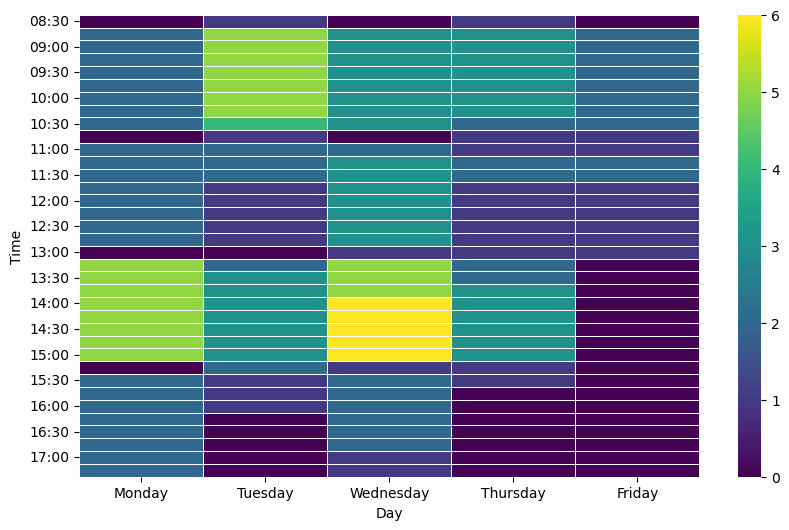

<Figure size 640x480 with 0 Axes>

In [11]:
# Convert times to a proper format for manipulation

import pandas as pd
def convert_to_minutes(time_str):
    """Convert HHMM time string to minutes since midnight"""
    if len(time_str) == 3:
        #e.g. 100
        time_str = "0"+time_str
    hours = int(time_str[:2])
    if hours < 8:
        hours += 12 #1 becomes 13 so 1pm sorts after 8am
    minutes = int(time_str[2:]) if len(time_str) > 2 else 0
    return hours * 60 + minutes

# Generate half-hour intervals and expand the DataFrame
def generate_half_hour_intervals(start_minutes, end_minutes):
    """Generate half-hour intervals between start and end times"""
    intervals = []
    current = start_minutes
    while current < end_minutes:
        intervals.append(current)
        current += 15  # increment by 30 minutes (half an hour)
    return intervals

# Function to expand shorthand dates into full days
def expand_days(short_days):
    days = []
    
    # Define mapping from shorthand to full day names
    day_mapping = {
        'M': 'Monday',
        'T': 'Tuesday',
        'W': 'Wednesday',
        'Th': 'Thursday',
        'F': 'Friday'
    }

    # Sort day_mapping by length of keys (longer keys first) to ensure proper matching
    sorted_day_mapping = dict(sorted(day_mapping.items(), key=lambda item: -len(item[0])))
    
    i = 0
    while i < len(short_days):
        # Check if current and next character form a valid shorthand (e.g., 'Th')
        if i + 1 < len(short_days) and short_days[i:i+2] in sorted_day_mapping:
            days.append(sorted_day_mapping[short_days[i:i+2]])
            i += 2
        elif short_days[i] in sorted_day_mapping:
            days.append(sorted_day_mapping[short_days[i]])
            i += 1
        else:
            # Handle any unexpected cases
            i += 1
    return days


def generate_schedule_heatmap(master_schedule,division="BBIO",year=2024,quarter="WIN"):
    "Generate a schedule heatmap for faculty from a master schedule"
    print(master_schedule.columns)
    master_schedule = master_schedule[master_schedule["Year"] == 2024]
    master_schedule = master_schedule[master_schedule["Quarter"] == "WIN"]
    master_schedule = master_schedule[master_schedule["Division"]=="BBIO"]
    df = master_schedule.loc[:,['Instructor','Meeting Times','Meeting Day']]

    df[['Start Time', 'End Time']] = df['Meeting Times'].str.split('-', expand=True)

    

    df['Start Minutes'] = df['Start Time'].apply(convert_to_minutes)
    df['End Minutes'] = df['End Time'].apply(convert_to_minutes)
    
    # Create a new DataFrame to hold the expanded entries
    expanded_rows = []
    for _, row in df.iterrows():
        intervals = generate_half_hour_intervals(row['Start Minutes'], row['End Minutes'])
        for interval in intervals:
            # Convert minutes back to HHMM format
            hour = interval // 60
            minute = interval % 60
            time_str = f"{hour:02d}{minute:02d}"
            expanded_rows.append({
                'Instructor': row['Instructor'],
                'Meeting Time': time_str,
                'Day': row['Meeting Day']
            })
    
    expanded_df = pd.DataFrame(expanded_rows)

    # Print the expanded DataFrame
    print(expanded_df['Day'].unique())
    expanded_df

    # Define mapping from shorthand to full day names
    day_mapping = {
        'M': 'Monday',
        'T': 'Tuesday',
        'W': 'Wednesday',
        'Th': 'Thursday',
        'F': 'Friday'
    }

    # Sort day_mapping by length of keys (longer keys first) to ensure proper matching
    sorted_day_mapping = dict(sorted(day_mapping.items(), key=lambda item: -len(item[0])))

    # Expand the shorthand dates into full days and create a new DataFrame
    expanded_entries = []
    for _, row in expanded_df.iterrows():
        days = expand_days(row['Day'])
        for day in days:
            expanded_entries.append({
                'Instructor': row['Instructor'],
                'Time': row['Meeting Time'],
                'Day': day
            })

    expanded_df = pd.DataFrame(expanded_entries)
    expanded_df["Time"]=pd.to_numeric(expanded_df["Time"])

    # Print the expanded DataFrame
    print(expanded_df)
    
    counts = expanded_df.groupby(['Time', 'Day']).size().reset_index(name='Instructor Count')

    # Pivot the DataFrame
    pivot_table = counts.pivot_table(index='Time', columns='Day', values='Instructor Count',fill_value=0)

    # Define the custom order for days of the week
    day_order = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday']

    # Reorder columns based on the custom order
    pivot_table = pivot_table[day_order]

    # Sort rows by times (index), assuming index is in HHMM format
    pivot_table.index = pd.to_datetime(pivot_table.index, format='%H%M').strftime('%H:%M')
    pivot_table = pivot_table.sort_index()

    import seaborn as sns
    import matplotlib.pyplot as plt
    %matplotlib inline
    # Create a heatmap
    plt.figure(figsize=(10, 6))
    sns.heatmap(pivot_table, cmap='viridis', linewidths=.5)
    plt.show()
    plt.savefig(f"schedule_heatmap_{division}_{year}_{quarter}.png")    
    pivot_table.to_csv(f"schedule_time_counts_{division}_{year}_{quarter}.csv")
    expanded_df.to_csv(f"expanded_schedule_by_instructor_{division}_{year}_{quarter}.csv")

    
current_year = 2025
current_quarter = 'AUT'
generate_schedule_heatmap(master_schedule,year=current_year,quarter=current_quarter)